In [108]:
%matplotlib inline
import matplotlib
from matplotlib import pyplot as plt

import numpy as np
import pandas as pd
from astropy.table import Table
from astropy.io import fits
from astroquery.sdss import SDSS
from urllib.request import urlopen
import bz2
import io
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import astropy.units as u
import subprocess
from astropy.convolution import convolve, Box2DKernel

matplotlib.rcParams['figure.facecolor'] = 'w'
def setImgSize(width, height): matplotlib.rcParams['figure.figsize'] = [width, height]
def setFontSize(size): matplotlib.rc('font', size=size)


In [2]:
catSDSS = Table.from_pandas(pd.read_csv('mikesandboximgs/catalog.csv',index_col = False))

In [3]:
catSDSS

specObjID,class,subClass,z,ra,dec,plate,fiberID,MJD,OII3726,OIII4959,OIII5007,HBeta,HAlpha,NII6584,logM
int64,str6,str13,float64,float64,float64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64
1109090338984716288,GALAXY,STARFORMING,0.0645438,315.903,-1.2285646,985,287,52431,80.6043,19.88178,62.38308000000001,48.43876,158.3462,30.69232,10.039219930207803
1112474362390276096,GALAXY,--,0.2234196,321.6379100000001,-1.1228035,988,310,52520,6.89355,1.433883,1.358712,-19.07879,-1.009784,10.12107,11.513085126453301
1158565346647500800,GALAXY,STARFORMING,0.13620339999999995,324.56033,-0.7832213000000001,1029,52,52912,39.15007,11.09579,27.12723,63.41087,235.1983,83.9248,10.0522017709479
1257694565775730688,GALAXY,STARBURST,0.07841583,309.7023,-0.22637,1117,234,52885,429.2838,98.89053,282.5724,642.7031,2897.423,1238.086,11.0510632987819
1106787686959572992,GALAXY,STARBURST,0.053935300000000005,313.83986,-0.4135969,983,102,52443,389.1815,100.4663,300.6974,243.6258,857.1979,161.17700000000005,10.070017488963302
1107959766338004992,GALAXY,--,0.16102139999999998,313.84397,-0.21567006,984,270,52442,-2.921211,0.5868384,-3.145225,2.777259,1.719148,-2.504817,11.322639788478199
1151825063914268672,GALAXY,STARBURST,0.1052657,313.97955,-0.38000929,1023,107,52818,100.9711,60.348180000000006,166.9989,87.07244,284.0529,55.07619,9.811521031712509
1109017496339376128,GALAXY,STARBURST,0.06095252,317.92962,-0.2488862,985,22,52431,104.6725,34.55397,110.3786,64.19955999999999,210.2455,29.92712,9.80370657856509
1113576896802613248,GALAXY,STARBURST,0.0312197,323.21669,-0.31125654,989,225,52468,175.921,42.29002,132.1998,126.7821,394.1497,78.76794,9.76424917347831


In [4]:
def map_Lupton04(r,g,b,beta=3.,args={}):
    """Lupton et al. (2004) mapping
    DESCRIPTION
      First define radius: rad = beta * (r + g + b).  Then the mapping is
      given by
        R = r*f(rad), G = g*f(rad), B = b*f(rad) ,
      where
               / 0,                     x <= 0 ,
        f(x) = |
               \ arcsinh(x) / x,        x > 0 .
      Hence the mapped values are NOT normalized to [0,1].  Saturation and
      max(R,G,B) > 1 cases have not been taken care of.
    """
    N = np
    # prepare various parameters
    if 'beta' in args: beta = args['beta']
    r,g,b = N.asarray(r).copy(),N.asarray(g).copy(),N.asarray(b).copy()
    # make sure all the entries are >= 0
    r = N.where(r>0., r, 0.)
    g = N.where(g>0., g, 0.)
    b = N.where(b>0., b, 0.)
    # compute nonlinear mapping
    radius = beta * (r + g + b)
    radius_ok = radius > 0.0
    nlfac = radius * 0.0
    nlfac[radius_ok] = N.arcsinh(radius[radius_ok])/radius[radius_ok]
    r = r*nlfac
    g = g*nlfac
    b = b*nlfac
    if args.get('desaturate'):
        # optionally desaturate pixels that are dominated by a single
        # colour to avoid colourful speckled sky
        a = (r+g+b)/3.0
        N.putmask(a, a == 0.0, 1.0)
        rab = r / a / beta
        gab = g / a / beta
        bab = b / a / beta
        mask = N.array((rab, gab, bab))
        w = N.max(mask, 0)
        N.putmask(w, w > 1.0, 1.0)
        w = 1 - w
        w = N.sin(w*N.pi/2.0)
        r = r*w + a*(1-w)
        g = g*w + a*(1-w)
        b = b*w + a*(1-w)
    # optionally add a grey pedestal
#     if args.has_key('pedestal'):
#         pedestal = args['pedestal']
#         r += pedestal
#         g += pedestal
#         b += pedestal
    return r, g, b

# Color balances and Lupton scales I, R, G bands into RGB image
def IRG2RGB(irgFlux):
    colorScale = {'i':8, 'r':8, 'g':8}
    colorBands = {f: irgFlux[f] * colorScale[f] for f in 'irg'}
    r, g, b = map_Lupton04(colorBands['i'], colorBands['r'], colorBands['g'])
    return np.dstack((r, g, b))

# Convenience function to view a black-and-white image of a single band
def band2RGB(bandFlux):
    irgFlux = {f: bandFlux for f in 'irg'}
    return IRG2RGB(irgFlux)

In [5]:
def requestPhotoObj(specObjId, bands='zirgu'):
    bands = bands.lower()
    fieldsSingle = [
        'p.specobjid',
        'p.objid',
        'p.ra',
        'p.dec',
        'p.run',
        'p.rerun',
        'p.camcol',
        'p.field',
        's.z'
    ]
    fieldsBandedTemplates = [
#         'p.psffwhm',
#         'p.expRad',
#         'p.expAB',
#         'p.expPhi',
    ]
    fieldsBanded = [fbt + '_' + b for fbt in fieldsBandedTemplates for b in bands]
    
    fields = fieldsSingle + fieldsBanded
    fieldsStr = ', '.join(fields)
    
    photoTable = 'PhotoPrimary'
    query = ("SELECT {}"
             " FROM {} AS p"
             " JOIN SpecPhoto AS s "
             " ON s.specobjid=p.specobjid"
             " WHERE p.specobjid = {}".format(fieldsStr, photoTable, specObjId)
            )
    
    result = SDSS.query_sql(query)
    if result is None: return None
    resultDict = {cn: result[cn][0] for cn in result.colnames}
    
    return resultDict

def zeroPad(s, numDigits):
    ss = str(s)
    return "0"*(numDigits-len(ss))+ss

def getFitsUrl(photoObjDict, filterBand):
    run = photoObjDict['run']
    rerun = photoObjDict['rerun']
    camcol = photoObjDict['camcol']
    field = photoObjDict['field']
    field4 = zeroPad(field, 4)
    run6 = zeroPad(run, 6)
    return "http://dr12.sdss.org/sas/dr12/boss/photoObj/frames/{RERUN}/{RUN}/{CAMCOL}/frame-{FILTER}-{RUN6}-{CAMCOL}-{FIELD}.fits.bz2".format(
        RERUN=rerun, RUN=run, CAMCOL=camcol, FIELD=field4, RUN6=run6, FILTER=filterBand
    )

# Gets the actual FITS file in a given band
# You can just plug in the dict returned by "requestPhotoObj"
def requestFitsFile(photoObjDict, filterBand):
    filterBand = filterBand.lower()
    fitsUrl = getFitsUrl(photoObjDict, filterBand)
    try:
        response = urlopen(fitsUrl)
    except Exception as e:
        # If anything goes wrong while requesting, return None and continue
        print("Could not retrieve FITS file.")
        print("photoObjDict:", photoObjDict)
        print("Exception:", e)
        return None
    fileZipped = response.read()
    fileBytes = bz2.decompress(fileZipped)
    file = io.BytesIO(fileBytes)
    fitsFile = fits.open(file)
    return fitsFile

# Returns a dict with fits files in the requested bands
def requestFitsFiles(photoObjDict, bands='zirgu'):
    return {f: requestFitsFile(photoObjDict, f) for f in bands}

def getHDUs(fitsBands):
    return {f: fitsBands[f][0] for f in fitsBands}

def trimFits(hdu, xMin, xMax, yMin, yMax):
    hdu.header['CRPIX2'] -= xMin
    hdu.header['CRPIX1'] -= yMin
    hdu.header['NAXIS2'] = xMax - xMin
    hdu.header['NAXIS1'] = yMax - yMin
    hdu.data = hdu.data[yMin:yMax, xMin:xMax]
    return hdu

def makeCutout(hdu, ctrRaDec, sideLen):
    wcs = WCS(hdu.header)
    ctrX, ctrY = wcs.wcs_world2pix([ctrRaDec], 0).astype('int')[0] # Casting to int rounds it
    pm = int(sideLen/2)
    xMin, xMax = ctrX-pm, ctrX+pm
    yMin, yMax = ctrY-pm, ctrY+pm
    return trimFits(hdu, xMin, xMax, yMin, yMax)

In [6]:
srcInfo = requestPhotoObj(catSDSS['specObjID'][0])
fitsFiles = requestFitsFiles(srcInfo)
hdus = getHDUs(fitsFiles)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


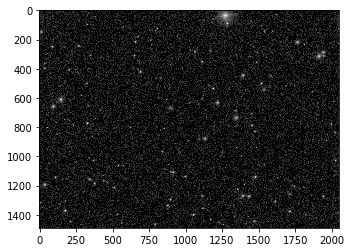

In [82]:
scaledImg = band2RGB(hdus['r'].data)
plt.imshow(scaledImg)

In [8]:
# Creates a galaxy id column and the ability to create new ids. 

from uuid import uuid4
def getUUID(d=12):
    return int(str(uuid4().int)[:d])

In [9]:
def skyDistArcsec(raDec1, raDec2):
    ra1,dec1 = raDec1
    ra2,dec2 = raDec2
    return SkyCoord(ra=ra1*u.deg, dec=dec1*u.deg).separation(SkyCoord(ra=ra2*u.deg, dec=dec2*u.deg)).to(u.arcsec).value

Image 0
Retrieving images...
done!
    specObjID      class  subClass          z              ra        dec     plate fiberID  MJD  OII3726    OIII4959  OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ------------------- ---------- ---------- ----- ------- ----- -------- ----------- -------- -------- -------- -------- ---------------- ------------ ------------
771404475746248704 GALAXY       -- 0.08652489999999999 0.70598552 0.75185845   685     593 52203 29.94103 -0.09967243 17.07917 14.57915 41.93857 44.27714 11.0155415631515 291287348869         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


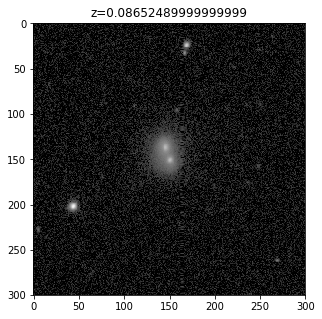

Image 1
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha   NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- ---------- ---------- ----- ------- ----- -------- --------- -------- -------- -------- --------- ------------------ ------------ ------------
771396779164854272 GALAXY       -- 0.1950856 0.88510899 0.47030617   685     565 52203 6.390059 -5.783329 -1.18514 14.45015 58.98888 0.6417232 11.729373801739197 314041726510         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


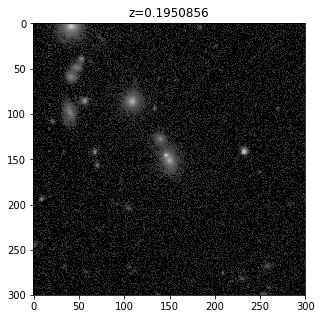

Image 2
Retrieving images...
done!
     specObjID      class   subClass     z        ra     dec   plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- --------- ------- ------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1227337874668546048 GALAXY STARBURST 0.1014318 1.12988 1.24095  1090     389 52903 161.5215 38.52794 118.7884 211.1599 924.6381 331.2561 10.6941464550793 104958404692         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 3
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z         ra         dec      plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- --------- --------- ------------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
772408884919822336 GALAXY STARFORMING 0.1584809 2.1158461 -0.0049286293   686     151 52519 97.30531 28.47826 92.16479 202.3467 848.5781 487.7298 11.2074921690422 248898510424         True


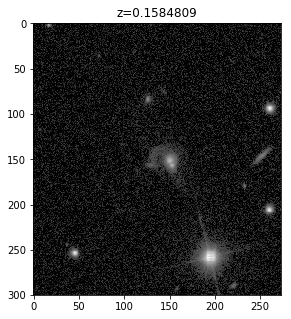

Image 4
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z          ra       dec    plate fiberID  MJD  OII3726  OIII4959      OIII5007      HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- ---------- --------- --------- ----- ------- ----- -------- -------- ----------------- -------- -------- -------- ------------------ ------------ ------------
772514163158181888 GALAXY STARFORMING 0.07997651 2.1356845 1.0390565   686     534 52519 6.322238 8.852282 8.862369000000003 25.07563 117.1445 40.11212 10.705346448209902 122383110702         True


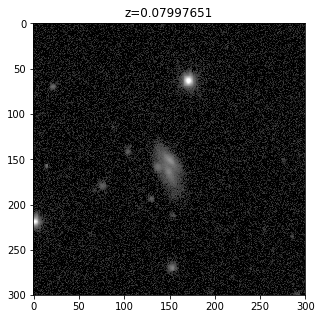

Skpping image 122383110702 (repeat)
Image 6
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z         ra     dec    plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha       NII6584            logM        galaxy_id   file_created
------------------- ------ ----------- ---------- ------- -------- ----- ------- ----- ------- -------- -------- -------- -------- ----------------- ---------------- ------------ ------------
1227242492034836480 GALAXY STARFORMING 0.03161843 2.52555 -0.43833  1090      42 52903 169.389 94.78285 269.5726 144.6712 592.8812 87.44228000000003 9.04386283511927 134750069507         True


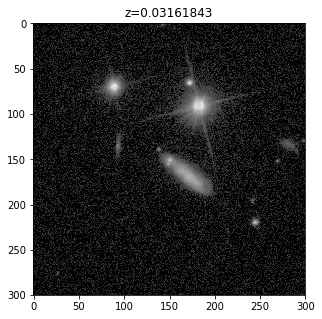

Image 7
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD       OII3726       OIII4959 OIII5007        HBeta          HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- ------------------ -------- -------- -------------------- -------- -------- ------------------ ------------ ------------
753247971331565568 GALAXY       -- 0.2426907 2.6033431 0.12353541   669      76 52559 1.7230990000000002 1.365789 1.423643 -0.27835370000000004 1.187787 2.541595 11.135836122830696 138419711372         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


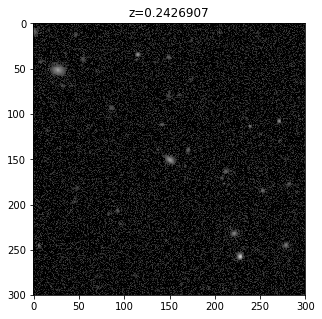

Image 8
Retrieving images...
done!
    specObjID      class   subClass     z         ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- -------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
437011371901609984 GALAXY STARBURST 0.07254893 2.932049 0.52288723   388     590 51793 103.0452 19.89781 76.37225 75.25445 390.8051 101.4208 10.2415870486922 699519924157         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


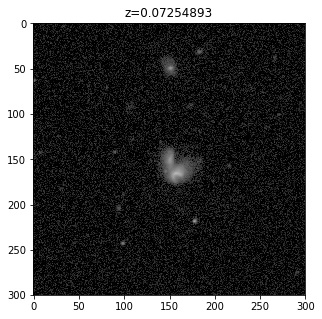

Skpping image 699519924157 (repeat)
Image 10
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
439196653056976896 GALAXY STARFORMING 0.08595943 3.8250053 0.24905877   390     348 51900 17.72172 5.793704 11.96209 35.23146 143.2349 59.63425 10.5536365255832 243182368350         True


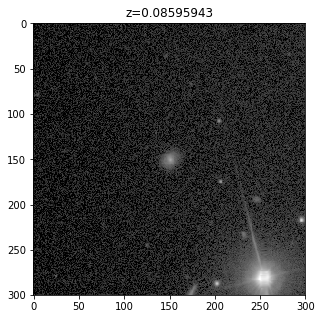

Image 11
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta   HAlpha  NII6584        logM       galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- ------- -------- -------- --------------- ------------ ------------
439174113068607488 GALAXY STARFORMING 0.06407763 4.4758677 -0.68636551   390     266 51900 17.58061 1.370315 10.73727 22.6954 121.7947 51.52168 10.305253495529 245492556782         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


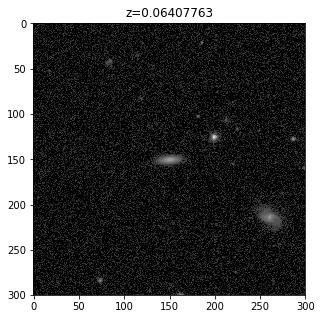

Image 12
Retrieving images...
done!
    specObjID      class   subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
774702735751669760 GALAXY STARBURST 0.06932662 4.6179256 -0.56956078   688     304 52203 231.0739 59.11306 179.3622 506.5872 1910.033 769.7728 10.4749873363757 138136253684         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


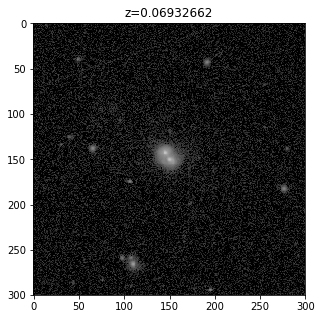

Image 13
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z         ra      dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- -------- -------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1678727256727382016 GALAXY STARFORMING 0.03292816 4.879452 -0.60177  1491      38 52996 55.34501 9.218669 32.70643 48.17247 156.0314 34.77625 7.90438092122952 230015943315         True


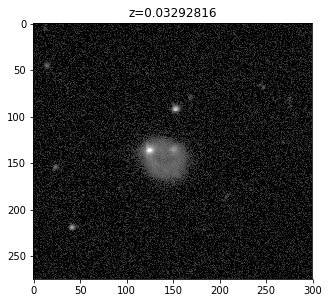

Image 14
Retrieving images...
done!
    specObjID      class  subClass     z         ra            dec         plate fiberID  MJD       OII3726       OIII4959  OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ------------------- ----- ------- ----- ----------------- ---------- -------- -------- -------- -------- ---------------- ------------ ------------
439135905039542272 GALAXY       -- 0.1066703 5.3675931 -1.2116578000000002   390     127 51900 6.818969999999998 -0.2373601  4.25218 16.79007 61.62316 27.52478 11.2903988400464 161540863429         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


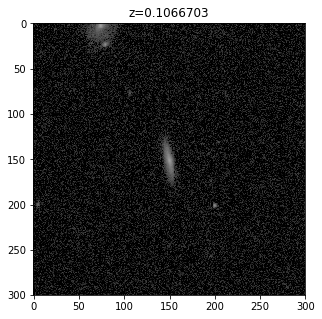

Image 15
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD   OII3726         OIII4959      OIII5007  HBeta    HAlpha        NII6584             logM       galaxy_id   file_created
------------------ ------ -------- --------- --------- ----------- ----- ------- ----- ---------- ------------------- -------- -------- -------- ------------------- --------------- ------------ ------------
774685968199346176 GALAXY       -- 0.1069878 5.4322707 -0.85434991   688     243 52203 -0.6646155 0.35444990000000004 2.263811 2.338246 10.18435 0.25381370000000003 11.237539176207 218496273335         True


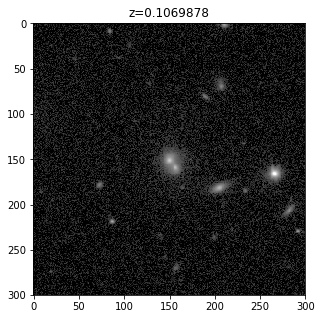

Skpping image 218496273335 (repeat)
Image 17
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass          z              ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------ ------ -------- ------------------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- ------- ---------------- ------------ ------------
774749464995850240 GALAXY       -- 0.07097139999999999 5.5362266 0.36681919   688     474 52203 28.91038 12.67599   25.877 16.29317 37.53477 26.8338 11.4289645363921 332307266559         True


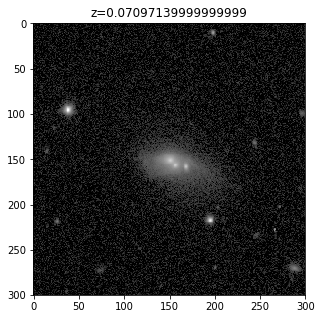

Image 18
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD       OII3726           OIII4959      OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ----------- ----- ------- ----- ----------------- ------------------ -------- -------- -------- -------- ------------------ ------------ ------------
439238984254646272 GALAXY       -- 0.1609743 5.7316244 -0.14667802   390     502 51900 8.297457000000001 0.4823729000000001 10.27811 8.389054 31.46767 28.23755 11.431395541783099 188384567398         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


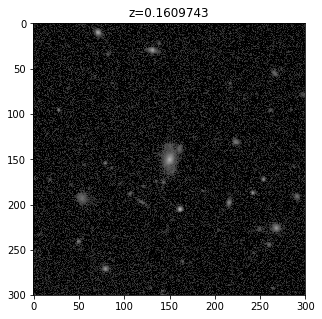

Image 19
Retrieving images...
done!
    specObjID      class   subClass     z         ra           dec         plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ --------- --------- --------- ------------------ ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
774731597931898880 GALAXY STARBURST 0.1035869 5.7573769 1.1832633999999995   688     409 52203 255.4436 37.20269 98.98019 148.6788 682.8881 261.1054 10.917581364495804 584162849695         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


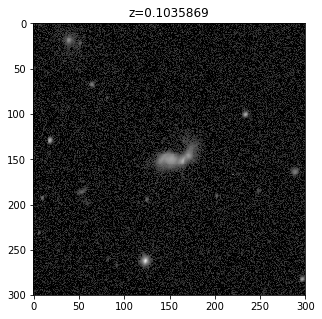

Image 20
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass    z        ra            dec          plate fiberID  MJD   OII3726    OIII4959       OIII5007       HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- -------- -------- -------------------- ----- ------- ----- ---------- --------- ------------------- -------- -------- -------- ------------------ ------------ ------------
1681051623251535872 GALAXY       -- 0.161115 5.780106 -0.06349199999999999  1493     302 52933 -0.4165095 -1.343201 0.14198629999999998 2.514859 9.438025 2.805508 11.645140980325401 691792363053         True


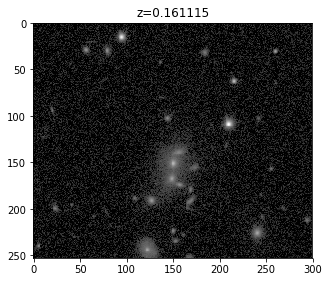

Image 21
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- ------------------ -------- -------- -------- ------- ---------------- ------------ ------------
439129033091868672 GALAXY       -- 0.06341135 5.9159769 -0.81535711   390     102 51900 15.99317 0.8800245999999999 18.85172 14.66265 33.33404 47.1016 11.1434126509972 279939129081         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


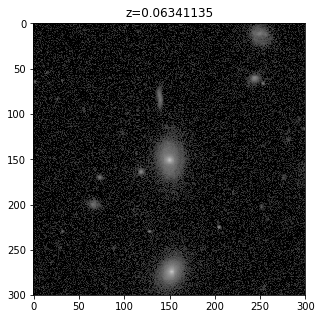

Image 22
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- --------- ----- ------- ----- -------- -------- -------- -------- ------- -------- ---------------- ------------ ------------
439105393591871488 GALAXY STARFORMING 0.05847439 5.9794532 -1.094463   390      16 51900 48.77677 4.453621 22.25835 67.33503 228.021 73.07526 9.92324198475995 956346864708         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


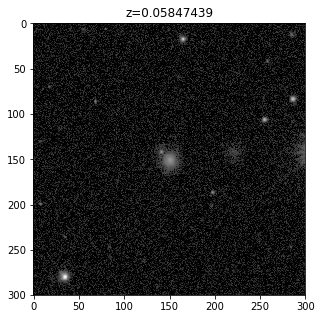

Image 23
Retrieving images...
done!
    specObjID      class    subClass      z              ra                 dec         plate fiberID  MJD  OII3726 OIII4959      OIII5007       HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ------------------ ------------------- ----- ------- ----- ------- -------- ------------------ -------- -------- -------- ---------------- ------------ ------------
440262627600394240 GALAXY STARFORMING 0.01300359 6.9572205999999985 -1.1999658000000002   391     130 51782     0.0 10.37934 31.238570000000006 40.84049 124.9116 37.84107 9.74042534835965 116091999000         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


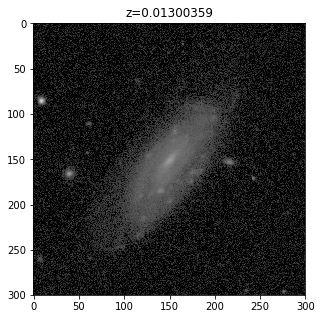

Image 24
Retrieving images...
done!
    specObjID      class    subClass      z              ra            dec      plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta   HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ----------------- ------------ ----- ------- ----- -------- -------- -------- ------- -------- -------- ---------------- ------------ ------------
774629618228422656 GALAXY STARFORMING 0.06849708 7.228550599999998 -0.073011798   688      38 52203 16.45159 11.75494 22.41256 60.8106 285.6953 117.4149 10.7811450661462 180239978827         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


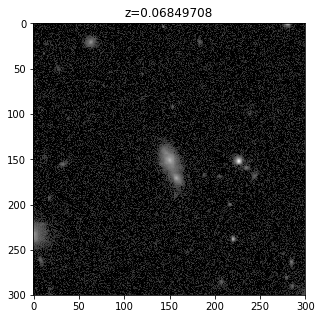

Image 25
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
440364882181777408 GALAXY STARFORMING 0.01384861 7.4099163 0.41037371   391     502 51782     0.0 31.35988 99.56178 83.55561 262.4785 54.75702 9.59479706440307 782668678393         True


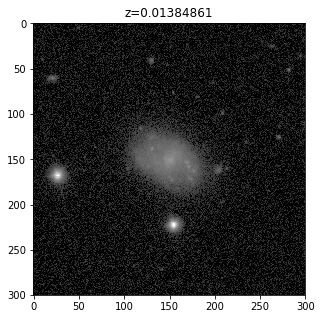

Image 26
Retrieving images...
done!
    specObjID      class  subClass     z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
775873991503013888 GALAXY      AGN 0.05976128 7.4370886 0.16973962   689     469 52262 534.5162 966.2611 2908.401 358.0985 1314.589 704.3556 10.5299408254284 164936466491         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


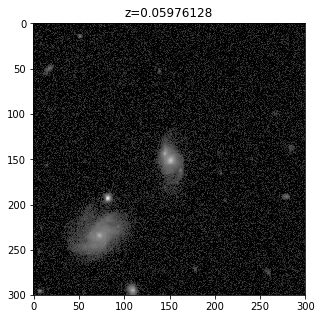

Image 27
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z              ra            dec     plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ----------------- ----------- ----- ------- ----- -------- ------------------ -------- -------- -------- ------- ----------------- ------------ ------------
440241462001559552 GALAXY STARFORMING 0.04077142 7.555977799999999 -0.70791872   391      53 51782 136.2346 15.808420000000002 49.61586 105.4887 343.2317 112.001 9.921489274230133 185454475631         True


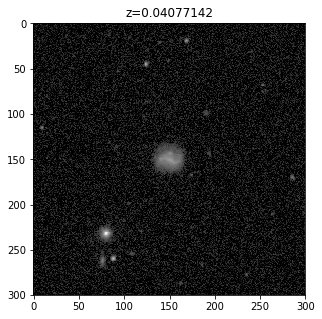

Image 28
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec    plate fiberID  MJD  OII3726       OIII4959           OIII5007      HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- --------- ----- ------- ----- -------- ------------------ ----------------- -------- -------- -------- ---------------- ------------ ------------
440238713222490112 GALAXY       -- 0.2260583 7.5855994 -1.112799   391      43 51782 5.892871 -3.897866000000001 7.107264999999999 5.398806 33.00159 31.91165 11.8618117257105 225344090763         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


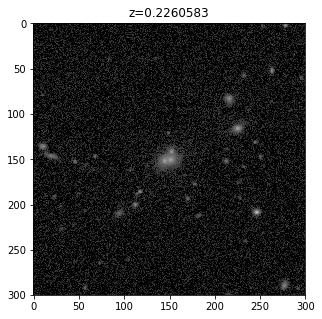

Image 29
Retrieving images...
done!
    specObjID      class    subClass           z              ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ------------------- --------- --------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
440393469484099584 GALAXY STARFORMING 0.06704960000000001 7.8498172 1.1397988   391     606 51782 29.67202 3.223091 13.67814 60.83805 224.4073 69.86111 10.4159547977542 331895498182         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


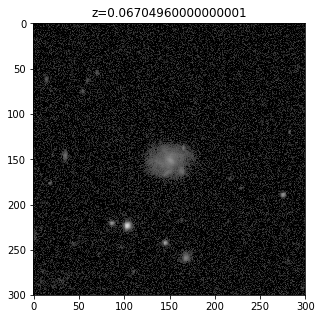

Image 30
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD       OII3726       OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- ------------------ -------- -------- -------- -------- -------- ---------------- ------------ ------------
440387971925960704 GALAXY       -- 0.1486622 7.8584102 0.47364473   391     586 51782 7.4840300000000015 5.030876 3.798618 6.844504 7.536026 4.975536 11.2685256440855 296971647936         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


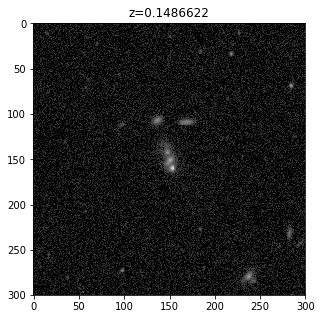

Image 31
Retrieving images...
done!
    specObjID      class   subClass     z          ra       dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ---------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ----------------- ------------ ------------
440398692164331520 GALAXY STARBURST 0.01378591 8.3117996 0.20101874   391     625 51782     0.0 86.67119 261.0697 126.4112 450.5949 50.14943 9.307373327436279 286497168966         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


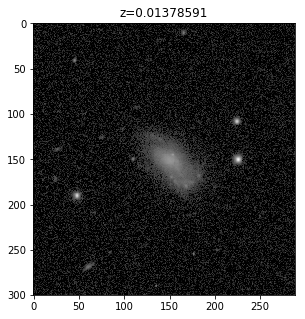

Image 32
Retrieving images...
done!
    specObjID      class    subClass      z              ra           dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha       NII6584            logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ----------------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- ----------------- ---------------- ------------ ------------
441480611790612480 GALAXY STARFORMING 0.04791996 8.901928300000002 0.54383147   392     465 51793 36.09406 13.49774 46.73304 20.86044 67.20561 6.229362999999998 9.51048909466083 325218230009         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


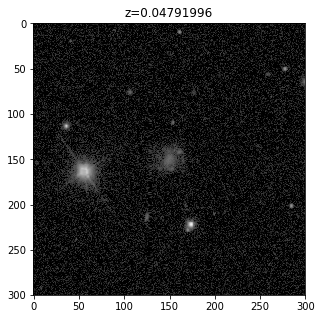

Image 33
Retrieving images...
done!
    specObjID      class   subClass     z         ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- -------- ----------- ----- ------- ----- ------- -------- -------- -------- -------- ------- ----------------- ------------ ------------
442563081004935168 GALAXY STARBURST 0.01929348 10.14622 -0.29365619   393     307 51794     0.0  47.1627 145.7283 63.93784 197.3201 20.6376 9.210943929147358 125507859426         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


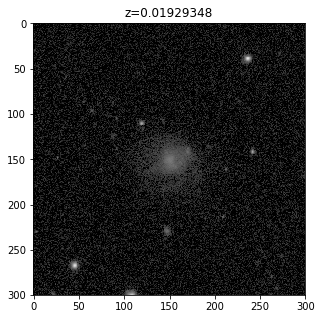

Image 34
Retrieving images...
done!
    specObjID      class    subClass      z         ra        dec      plate fiberID  MJD  OII3726      OIII4959      OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- --------- --------- ------------ ----- ------- ----- ------- ------------------ -------- -------- -------- -------- ---------------- ------------ ------------
441363788680161280 GALAXY STARFORMING 0.1092156 10.310215 0.0038287873   392      40 51793 15.3269 6.0496690000000015 39.16689 63.21929 404.9506 206.6456 11.2870358803229 387349392388         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 35
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
    specObjID      class  subClass     z          ra        dec      plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha       NII6584              logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ------------ ----- ------- ----- ------- --------- -------- -------- -------- ------------------ ----------------- ------------ ------------
442554559789819904 GALAXY       -- 0.01330698 10.349474 -0.064968354   393     276 51794     0.0 0.3852063 10.67733 11.60589 30.77504 5.4680290000000005 9.231849758689961 411035901216         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


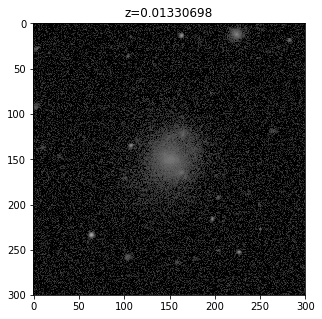

Image 36
Retrieving images...
done!
    specObjID      class  subClass     z         ra      dec    plate fiberID  MJD        OII3726             OIII4959       OIII5007   HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- -------- ----- ------- ----- ------------------- -------------------- -------- --------- -------- -------- ---------------- ------------ ------------
442589744161908736 GALAXY       -- 0.1957087 10.896086 1.019671   393     404 51794 -4.2193830000000005 -0.13364990000000002 2.572983 -15.12266 8.158224 4.501434 11.6245175314025 579179085904         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


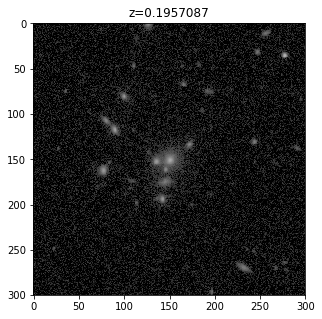

Image 37
Retrieving images...
done!
    specObjID      class  subClass     z         ra      dec    plate fiberID  MJD   OII3726   OIII4959  OIII5007  HBeta    HAlpha   NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- -------- ----- ------- ----- --------- ---------- -------- -------- -------- --------- ---------------- ------------ ------------
442608160981673984 GALAXY       -- 0.2170908 11.005655 0.115091   393     471 51794 -9.378204 -0.7537909 7.773489 2.683419 8.259134 -9.693906 11.6426217444755 313600892104         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


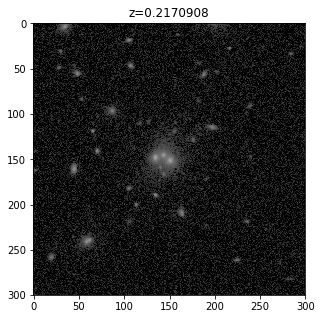

Image 38
Retrieving images...
done!
    specObjID      class  subClass     z        ra        dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007   HBeta         HAlpha        NII6584        logM       galaxy_id   file_created
------------------ ------ -------- --------- -------- ----------- ----- ------- ----- -------- --------- -------- --------- ------------------ --------- --------------- ------------ ------------
442503157621221376 GALAXY       -- 0.1114114 11.52086 -0.97721061   393      89 51794 1.176711 0.8396295 8.697359 -1.895381 0.8086488000000001 -5.364726 11.127036550981 589789235318         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


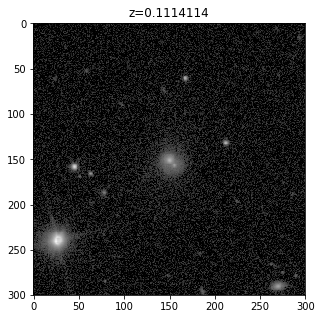

Image 39
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta   HAlpha  NII6584        logM       galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- ------- -------- -------- --------------- ------------ ------------
443730214594308096 GALAXY STARFORMING 0.05561816 12.788145 0.77445291   394     457 51913 103.5423 20.18027 57.03624 68.3772 249.6489 57.03389 10.085031246678 325578816514         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


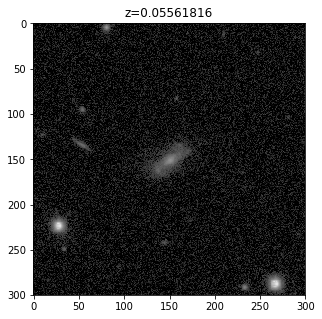

Image 40
Retrieving images...
done!
    specObjID      class  subClass     z          ra       dec     plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta   HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ---------- ----- ------- ----- -------- ------------------ -------- ------- -------- -------- ---------------- ------------ ------------
443739835321051136 GALAXY       -- 0.06905949 13.095631 0.66739895   394     492 51913 8.928235 6.2443620000000015 14.04334 5.03343 16.91817 15.26265 10.9622346472473 202970467960         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


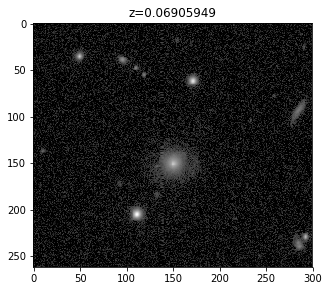

Image 41
Retrieving images...
done!
    specObjID      class   subClass     z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
779250590688503808 GALAXY STARBURST 0.03411131 13.240837 0.36876689   692     465 52201 1614.335 1030.394  3051.82 1062.583 3803.043 584.7609 9.97580579209424 316068722738         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


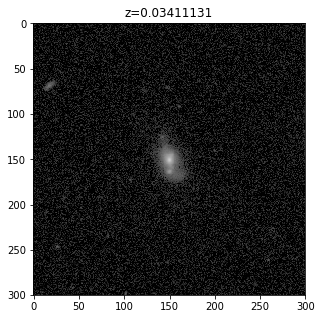

Image 42
Retrieving images...
done!
    specObjID      class   subClass          z                  ra            dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha NII6584        logM         galaxy_id   file_created
------------------ ------ --------- ------------------- ------------------ ---------- ----- ------- ----- -------- -------- -------- -------- ------- ------- ------------------ ------------ ------------
443763199943141376 GALAXY BROADLINE 0.06753510000000001 13.354576000000002 0.73750739   394     577 51913 19.82218 10.93205 25.18576 11.15251 39.5629  42.805 11.103583087384903 121510226292         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


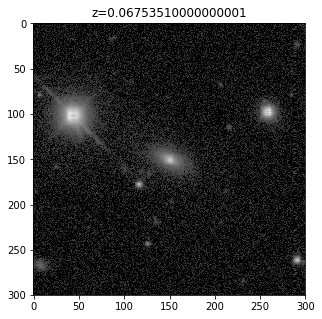

Image 43
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD       OII3726       OIII4959 OIII5007   HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- ---------- -------- ---------- ----- ------- ----- ------------------ -------- -------- --------- -------- -------- ------------------ ------------ ------------
443606794414090240 GALAXY       -- 0.04377864 13.62444 -1.1712639   394       8 51913 -58.12133000000001  1.90275 3.353726 0.5302493 3.385008 5.222072 10.145057301127801 148641661161         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 44
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class  subClass     z         ra      dec    plate fiberID  MJD       OII3726        OIII4959 OIII5007  HBeta         HAlpha       NII6584         logM         galaxy_id   file_created
------------------- ------ -------- ---------- -------- -------- ----- ------- ----- ------------------ --------- -------- -------- ------------------ -------- ------------------ ------------ ------------
1219415886964746240 GALAXY       -- 0.04522017 13.97926 -1.24685  1083     241 52520 1.9936080000000005 -11.70549 1.943856 17.71474 17.063979999999994 11.46758 10.531346119425802 114738430752         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


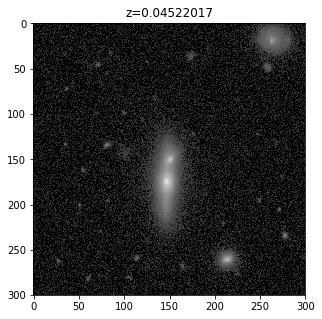

Image 45
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z             ra            dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- ------------------ ---------- ----- ------- ----- -------- --------- -------- -------- -------- -------- ------------------ ------------ ------------
444798937715468288 GALAXY       -- 0.0445981 13.979526000000002 -1.0641584   395     249 51783 7.567612 -3.834709 11.09632 18.70213 19.04378 20.43556 10.998597330640301 260211707445         True


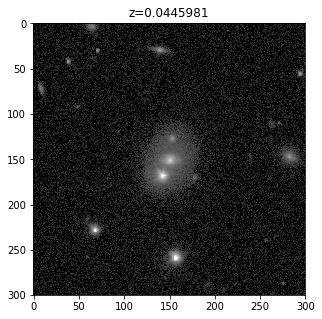

Image 46
Retrieving images...
done!
    specObjID      class  subClass     z          ra       dec     plate fiberID  MJD       OII3726       OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ---------- ----- ------- ----- ----------------- --------- -------- -------- -------- -------- ---------------- ------------ ------------
779145862205958144 GALAXY       -- 0.04069311 13.981962 -1.2472039   692      84 52201 61.03364000000001 -28.46306 52.57193 15.27591 58.06191 46.70645 11.2525606769542 232648926921         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


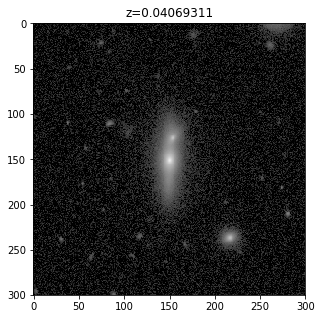

Image 47
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z          ra            dec         plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- ---------- --------- ------------------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
443611742216415232 GALAXY       -- 0.09852597 14.053001 -0.5966880999999999   394      26 51913 5.028214  -9.6913 10.40434 4.978717 1.482368 6.996591 11.342261299546099 449184222398         True


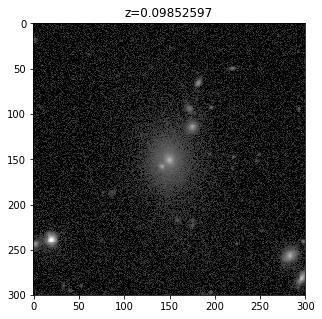

Image 48
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class   subClass     z        ra      dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- ------ ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
444839344767789056 GALAXY STARBURST 0.04616139 14.157 0.10387544   395     396 51783 109.2607 34.62978 95.29918 63.64505 212.9324 33.19068 9.84939138372666 318467049324         True


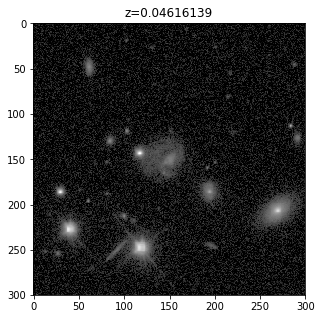

Image 49
Retrieving images...
done!
     specObjID      class  subClass     z         ra      dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007       HBeta         HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- --------- -------- ----- ------- ----- -------- -------- -------- ------------------ -------- -------- ---------------- ------------ ------------
1685607174014789632 GALAXY       -- 0.2716765 14.594543 0.056419  1497     491 52886 9.083892 4.086253 4.019687 16.785870000000006 92.76231 29.54343 11.4473573973735 928106385632         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


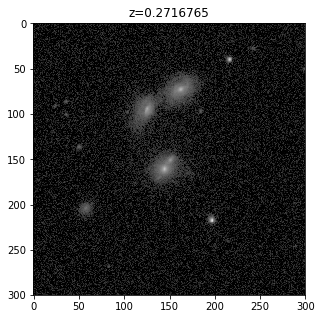

Image 50
Retrieving images...
done!
    specObjID      class    subClass           z              ra             dec          plate fiberID  MJD  OII3726      OIII4959      OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- ------------------- --------- --------------------- ----- ------- ----- ------- ------------------ -------- -------- -------- -------- ------------------ ------------ ------------
444869856215459840 GALAXY STARFORMING 0.14186310000000002 14.817347 -0.050816094000000006   395     507 51783 10.8206 6.8372720000000005 13.71807 34.19269 198.5035 138.2312 11.301451309001301 964090824278         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


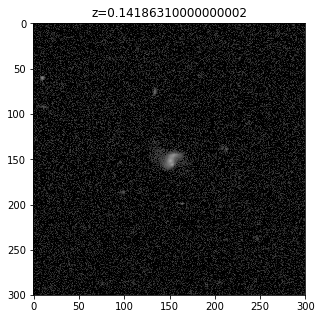

Image 51
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec      plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta     HAlpha   NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ------------ ----- ------- ----- -------- --------- -------- -------- ---------- -------- ---------------- ------------ ------------
444892945959643136 GALAXY       -- 0.1934781 15.329962 -0.055274078   395     591 51783 14.96928 -6.400512 6.609213 3.189376 0.03090043 23.89815 11.8153237208796 103284934494         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


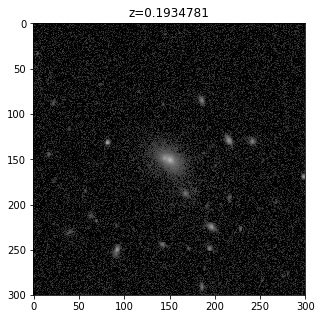

Image 52
Retrieving images...
done!
     specObjID      class  subClass    z        ra      dec   plate fiberID  MJD   OII3726    OIII4959   OIII5007   HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- -------- -------- ------- ----- ------- ----- ---------- ---------- ---------- -------- -------- -------- ------------------ ------------ ------------
1219523364226361344 GALAXY       -- 0.238107 15.84695 0.31917  1083     632 52520 -0.9907025 -0.7164873 -0.5412608 4.943053 3.381081 0.238913 10.786375221517599 293878124020         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


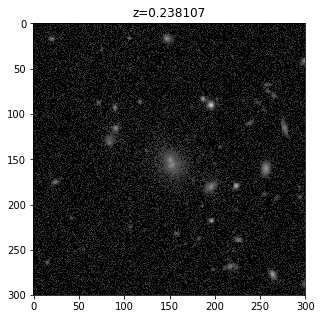

Image 53
Retrieving images...
done!
    specObjID      class  subClass     z              ra             dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- ------------------ ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
780264066420598784 GALAXY       -- 0.06579525 15.973820000000002 -0.83478107   693      56 52254 1.658898 4.491529 3.291727 11.34614 31.44289 17.29911 10.4653494646192 911420216547         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 54
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class  subClass     z         ra       dec    plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------- ------ -------- --------- --------- --------- ----- ------- ----- -------- --------- -------- -------- -------- ------- ---------------- ------------ ------------
1686669027839076352 GALAXY       -- 0.2000676 15.988249 -0.954761  1498     258 52914 6.459172 -3.931629 4.453228 9.985738 45.24969 14.7333 11.3418925119657 257566191669         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


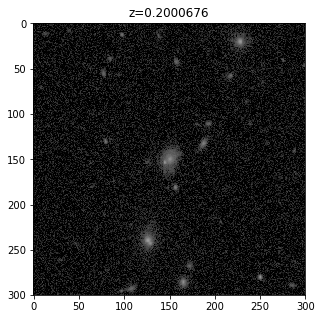

Image 55
Retrieving images...
done!
     specObjID      class   subClass     z              ra           dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ --------- ---------- ------------------ -------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1218283939794282496 GALAXY STARBURST 0.07935958 16.257820000000002 -1.20619  1082     219 52523 156.8191 25.63884 95.95827 162.1265 710.7548 237.6296 10.705653629770199 141993831391         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


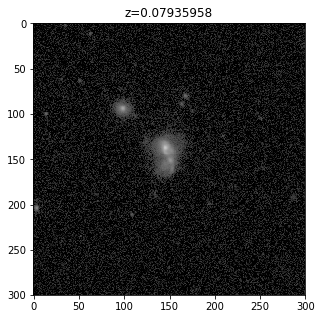

Image 56
Retrieving images...
done!
    specObjID      class    subClass      z              ra            dec     plate fiberID  MJD  OII3726  OIII4959      OIII5007            HBeta        HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ------------------ ---------- ----- ------- ----- -------- -------- ------------------ ----------------- -------- -------- ---------------- ------------ ------------
447079599893932032 GALAXY STARFORMING 0.05389864 16.957288000000002 0.61164219   397     354 51794 69.70734 7.733952 26.809890000000006 87.74051999999998 295.6137 80.70628 10.2200114453336 212878573355         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


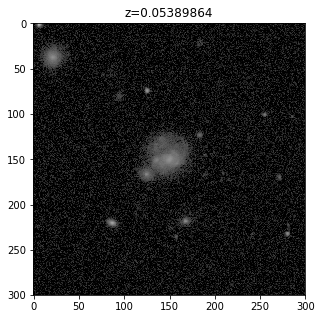

Image 57
Retrieving images...
done!
    specObjID      class  subClass     z          ra      dec    plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- -------- ----- ------- ----- -------- --------- -------- -------- -------- -------- ----------------- ------------ ------------
446024343978272768 GALAXY       -- 0.04303486 17.014725 1.083572   396     611 51816 28.37143 0.8215415 7.682822 8.105577 21.25267 6.453446 9.872348386283539 334450696903         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


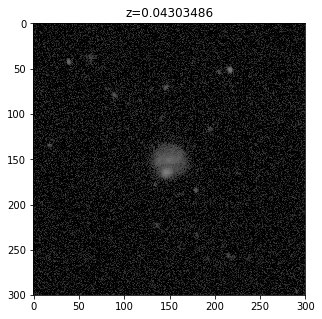

Image 58
Retrieving images...
done!
    specObjID      class    subClass      z         ra        dec     plate fiberID  MJD  OII3726        OIII4959      OIII5007  HBeta        HAlpha      NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- --------- --------- ----------- ----- ------- ----- -------- ------------------- -------- ------- ----------------- -------- ------------------ ------------ ------------
447047439178819584 GALAXY STARFORMING 0.1019214 17.375029 -0.30780245   397     237 51794 12.76648 -0.5590076999999999 5.890808 14.1273 77.04885999999998 26.16437 10.724019311333901 123320707235         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 59
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class  subClass     z        ra      dec    plate fiberID  MJD  OII3726  OIII4959      OIII5007       HBeta         HAlpha       NII6584         logM         galaxy_id   file_created
------------------- ------ -------- --------- -------- -------- ----- ------- ----- -------- -------- ------------------ -------- ------------------ -------- ------------------ ------------ ------------
1218240783962892288 GALAXY       -- 0.0889376 17.42427 -0.74044  1082      62 52523 26.22097 4.505372 14.759620000000002 13.57636 32.821909999999995 20.26368 11.002882945264899 262825284667         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


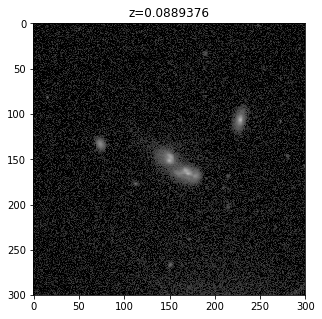

Skpping image 262825284667 (repeat)
Image 61
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec    plate fiberID  MJD  OII3726 OIII4959 OIII5007   HBeta    HAlpha NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- --------- ----- ------- ----- ------- -------- -------- --------- ------- -------- ---------------- ------------ ------------
447126054260205568 GALAXY       -- 0.1206645 18.403411 1.2426077   397     523 51794     0.0 15.03203 15.53416 -2.527496 31.0141 23.92174 11.0753411357939 190382487820         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


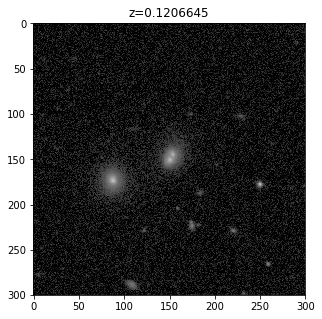

Image 62
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959      OIII5007      HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- ----------------- -------- -------- -------- ------------------ ------------ ------------
782562044850235392 GALAXY STARFORMING 0.09268148 18.487914 -0.19304324   695     224 52202 50.35054 12.03963 38.35254000000001 52.30167 185.7308 50.68965 10.282679946277801 137824349638         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


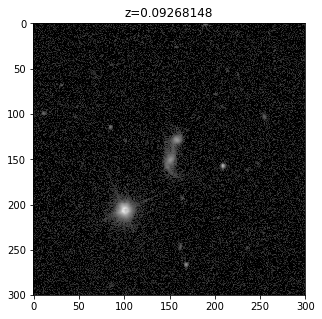

Image 63
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta         HAlpha       NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- ------------------ -------- ---------------- ------------ ------------
782554898024654848 GALAXY STARFORMING 0.08975019 18.920301 -0.14057211   695     198 52202 23.7927 5.396841 8.925456 10.82775 33.017140000000005 20.36129 10.6982440369444 347105508817         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


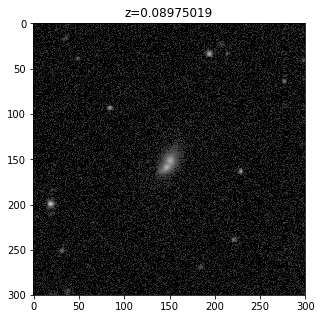

Skpping image 347105508817 (repeat)
Image 65
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD   OII3726  OIII4959  OIII5007   HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- --------- -------- --------- --------- -------- -------- ---------------- ------------ ------------
448152723158755328 GALAXY       -- 0.04483047 19.680679 -0.70191232   398     162 51789 0.2865652 10.10743 -2.417597 0.9757478 6.269781 11.54718 10.4112765242674 329635561727         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


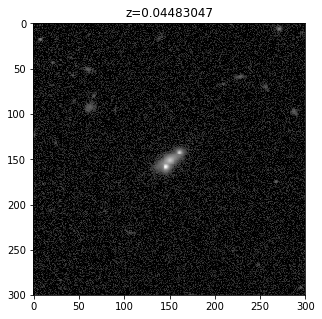

Image 66
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z         ra        dec     plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- --------- --------- ----------- ----- ------- ----- -------- ------------------ -------- -------- -------- -------- ------------------ ------------ ------------
448127159513409536 GALAXY STARFORMING 0.0540747 20.096709 -0.35240107   398      69 51789 112.7303 26.908040000000003 78.48186 50.99548 149.9309 33.54867 10.858243069302402 284498685903         True


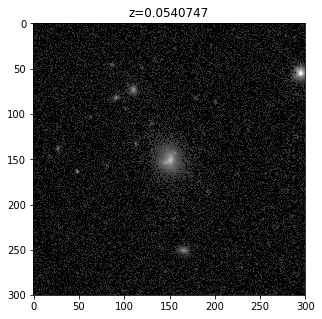

Image 67
Retrieving images...
done!
    specObjID      class  subClass     z          ra       dec     plate fiberID  MJD  OII3726 OIII4959      OIII5007            HBeta              HAlpha      NII6584         logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ---------- ----- ------- ----- ------- -------- ------------------ ------------------ ----------------- -------- ----------------- ------------ ------------
449331674971400192 GALAXY       -- 0.01265891 20.338844 0.09040488   399     355 51817     0.0 10.53103 17.175620000000002 16.649810000000002 63.95274000000001 15.54562 9.624328493836462 186713427923         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


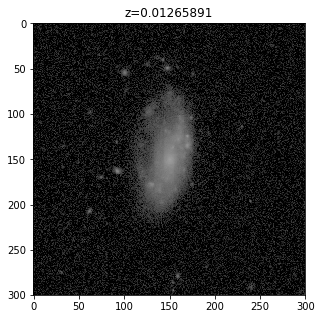

Image 68
Retrieving images...
done!
    specObjID      class   subClass     z         ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta         HAlpha      NII6584       logM        galaxy_id   file_created
------------------ ------ --------- ---------- -------- --------- ----- ------- ----- -------- -------- -------- -------- ----------------- ------- ---------------- ------------ ------------
449322604000471040 GALAXY STARBURST 0.05546235 20.57553 1.0072288   399     322 51817 1224.759 339.0022 1010.067 1151.595 4563.047000000001 1397.25 10.2300016301781 296542334200         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


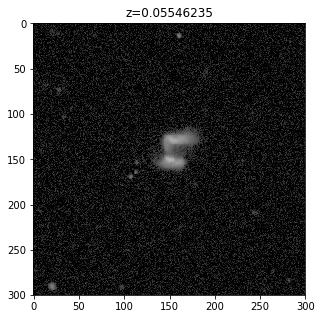

Image 69
Retrieving images...
done!
    specObjID      class  subClass          z              ra       dec    plate fiberID  MJD   OII3726   OIII4959      OIII5007           HBeta        HAlpha   NII6584         logM         galaxy_id   file_created
------------------ ------ -------- ------------------- --------- --------- ----- ------- ----- --------- --------- ----------------- ----------------- -------- --------- ------------------ ------------ ------------
449378953971394560 GALAXY       -- 0.20932110000000004 21.526825 1.2271074   399     527 51817 -1.583198 -2.146941 4.947405000000002 4.552708999999999 1.561105 0.2742342 11.580180513388695 244141348360         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


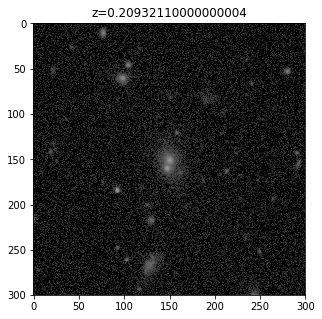

Image 70
Retrieving images...
done!
     specObjID      class    subClass      z        ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ ----------- --------- -------- --------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1690023101917587456 GALAXY STARFORMING 0.1039294 21.55142 -0.024638  1501     172 53740 20.90479 14.88171 53.01151 17.56699 98.01088 49.83669 10.744678635575099 246057444381         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


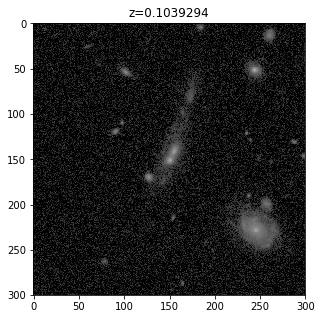

Image 71
Retrieving images...
done!
    specObjID      class   subClass     z          ra        dec     plate fiberID  MJD       OII3726      OIII4959 OIII5007  HBeta   HAlpha NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ----------- ----- ------- ----- ----------------- -------- -------- -------- ------ -------- ---------------- ------------ ------------
449262130860943360 GALAXY STARBURST 0.09179462 21.697255 -0.57926234   399     102 51817 85.33695999999998 22.97958 66.05975 181.0158 815.07 270.4847 10.7779444026235 126827171160         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


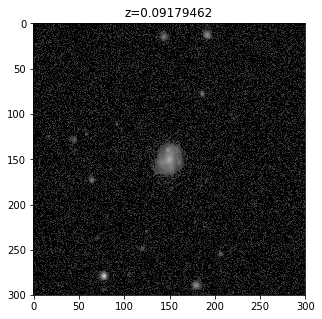

Image 72
Retrieving images...
done!
    specObjID      class    subClass      z         ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- -------- --------- ----- ------- ----- -------- -------- -------- -------- ------- -------- ---------------- ------------ ------------
450449878347180032 GALAXY STARFORMING 0.05905213 22.70639 1.2425688   400     327 51820 35.13625 9.031905 30.84281 26.96293 84.8399 18.60216 9.76773706420572 202693814184         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


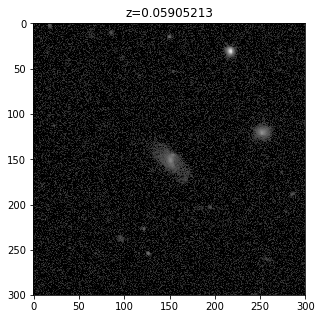

Image 73
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD   OII3726   OIII4959 OIII5007       HBeta             HAlpha       NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- --------- --------- -------- ----------------- ------------------ -------- ------------------ ------------ ------------
450370713509980160 GALAXY       -- 0.1499561 25.085786 -0.1135462   400      39 51820 0.2233392 -1.800447 2.907212 4.011933999999999 2.5124880000000003 1.410755 11.443443784347801 265566519672         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


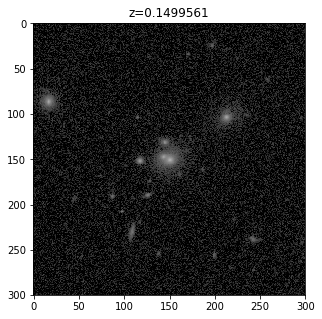

Image 74
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
451536745054365696 GALAXY STARFORMING 0.05832678 25.197745 -0.2182843   401     185 51788 74.07024 17.50479 61.96479 77.92085 300.4082 80.74634 10.0927838322089 196105575401         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


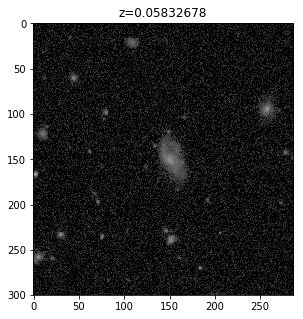

Image 75
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726   OIII4959  OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- -------- ---------- -------- -------- -------- -------- ------------------ ------------ ------------
451509807019485184 GALAXY       -- 0.1970321 25.892778 -1.0381848   401      87 51788 1.967259 -0.2439778 4.167192 0.231811 14.71563 4.831436 11.471739550513101 228709003104         True


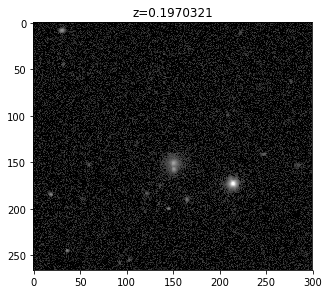

Image 76
Retrieving images...
done!
    specObjID      class    subClass     z         ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- -------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
451513380432275456 GALAXY STARFORMING 0.140943 25.955271 -0.81528001   401     100 51788 28.26961 3.385242  10.6121 44.92375 235.3208 116.3463 11.3338767118377 256048725811         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


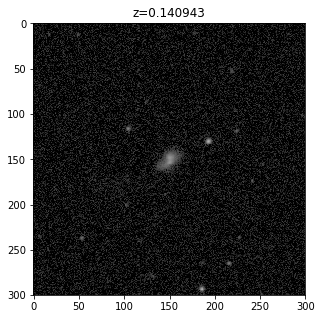

Image 77
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
787057398140397568 GALAXY STARFORMING 0.01800457 26.263764 -0.30157051   699     194 52202     0.0 2.776659  18.4996 16.99261 48.73297 10.38966 9.55980646166766 827979904209         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


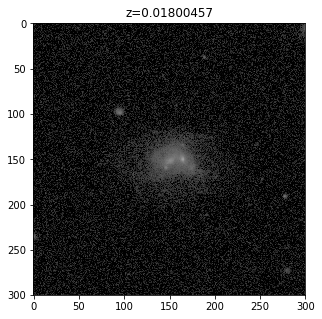

Image 78
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959      OIII5007       HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- -------- ------------------ -------- -------- -------- ------------------ ------------ ------------
452649725783468032 GALAXY       -- 0.06001446 28.137743 -0.96231233   402     138 51793 31.13934 3.630559 18.628870000000006 12.35341 128.5054 83.26185 10.925441276123399 163082477620         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


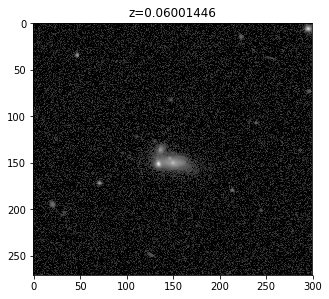

Image 79
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD   OII3726   OIII4959      OIII5007       HBeta     HAlpha   NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- --------- --------- ------------------ -------- ---------- -------- ---------------- ------------ ------------
452623887260215296 GALAXY       -- 0.2415867 28.357038 -1.1600102   402      44 51793 -6.918591 -4.107839 3.4683900000000003 4.193806 -0.2055367 3.506403 12.0238308879985 119449290549         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


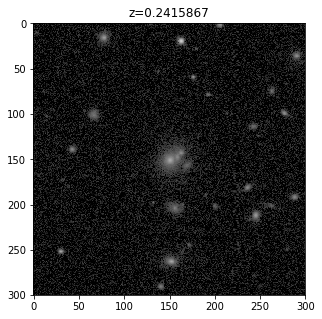

Image 80
Retrieving images...
done!
    specObjID      class    subClass      z          ra           dec         plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ------------------ ----- ------- ----- -------- -------- -------- -------- -------- ------- ---------------- ------------ ------------
452770122306709504 GALAXY STARFORMING 0.05932304 28.370513 0.8299681000000001   402     576 51793 28.92417 4.041717 12.39922 28.23539 133.3731 40.8715 10.1090941040983 979931510236         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


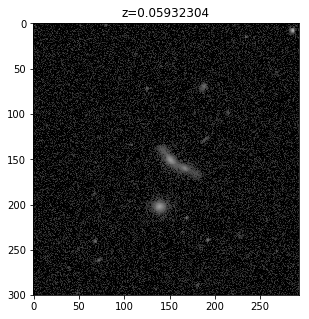

Image 81
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726      OIII4959     OIII5007  HBeta    HAlpha NII6584         logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ------- ----------------- -------- -------- ------- -------- ----------------- ------------ ------------
788167080200398848 GALAXY STARFORMING 0.01615442 28.496593 -0.75023391   700     135 52199     0.0 36.13254000000001  128.405 148.2366 494.948 108.8642 9.903062809861641 185205658996         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


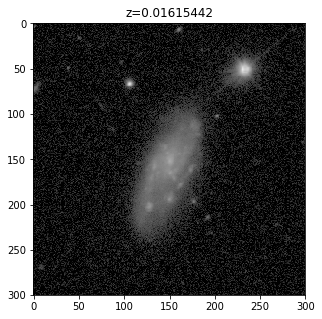

Image 82
Retrieving images...
done!
     specObjID      class  subClass     z             ra           dec   plate fiberID  MJD   OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- ------------------ ------- ----- ------- ----- --------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1210441405109921792 GALAXY       -- 0.1164574 28.539890000000003 0.12533  1075     360 52933 -1.443838  2.41701 15.64095 6.191543 25.37327 39.08546 10.9890063506894 313063224364         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


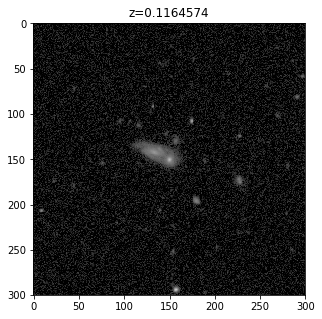

Image 83
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
789339983893784576 GALAXY STARFORMING 0.04667646 28.991958 -0.44446657   701     306 52179 133.1422 28.22656 66.19585 148.0303 587.2227 204.0575 10.3042027452979 658505252874         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


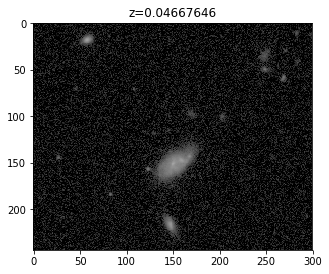

Image 84
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha       NII6584            logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- --------- -------- -------- -------- ----------------- ---------------- ------------ ------------
452622512870680576 GALAXY       -- 0.04554075 29.136491 -0.17425794   402      39 51793 40.31553 -2.942036 34.51645 19.37279 61.97155 52.63809000000001 10.9076213106691 142758736775         True


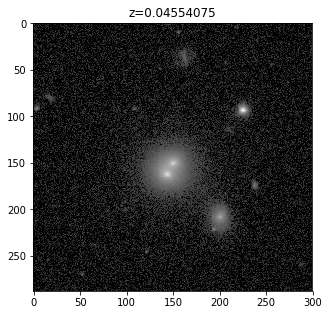

Image 85
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM         galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- ------- ------------------ ------------ ------------
789319917806577664 GALAXY STARFORMING 0.08023279 29.567302 -0.52252493   701     233 52179 178.9183 40.22821 127.1213 138.3665 707.6599 355.709 11.084288701388099 617288287737         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


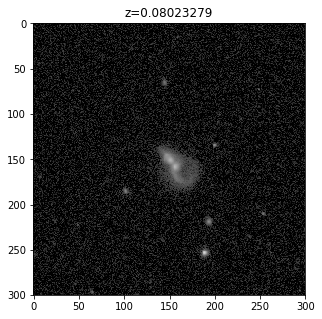

Image 86
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
453778650655909888 GALAXY       -- 0.1858547 29.581269 -0.61435932   403     149 51871 17.38128 4.093853 10.02158 5.696177 42.22498 36.76661 11.5584820221834 145995824044         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


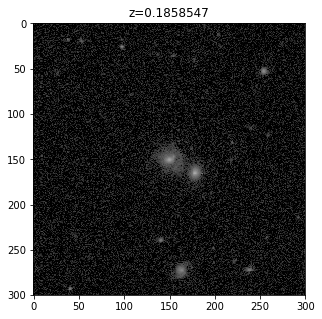

Image 87
Retrieving images...
done!
    specObjID      class  subClass     z             ra             dec     plate fiberID  MJD       OII3726        OIII4959 OIII5007        HBeta          HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- ------------------ ----------- ----- ------- ----- ------------------ --------- -------- -------------------- -------- -------- ---------------- ------------ ------------
453765456516376576 GALAXY       -- 0.1905612 29.694958000000003 -0.69474834   403     101 51871 3.0754330000000003 -4.105423 2.123152 -0.31355409999999995 9.140639 0.258377 11.6509512894732 265980518567         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


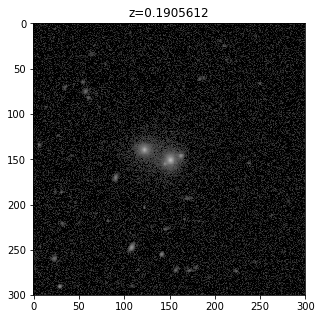

Image 88
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007   HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- -------- --------- -------- --------- -------- -------- ---------------- ------------ ------------
453894099376826368 GALAXY       -- 0.1672027 30.044287 0.89618419   403     569 51871 4.665034 -1.484382 4.065695 -1.835413 1.148147 1.124148 11.6203902169537 442265246095         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


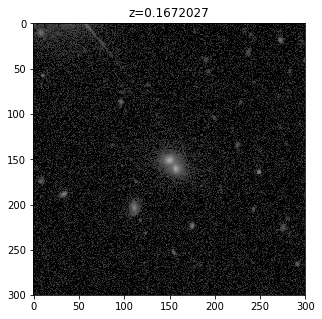

Skpping image 442265246095 (repeat)
Image 90
Retrieving images...
done!
    specObjID      class  subClass     z             ra            dec     plate fiberID  MJD   OII3726   OIII4959 OIII5007  HBeta    HAlpha   NII6584          logM         galaxy_id   file_created
------------------ ------ -------- --------- ------------------ ---------- ----- ------- ----- ---------- -------- -------- -------- -------- ---------- ------------------ ------------ ------------
789311121713555456 GALAXY       -- 0.2095318 30.057108000000003 -1.2040285   701     201 52179 0.09887064 4.401268 5.962465 8.090693 14.68907 -0.3732321 11.452624047938096 125275293743         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


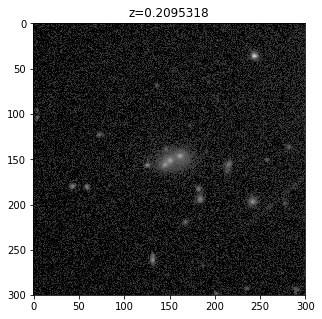

Image 91
Retrieving images...
done!
    specObjID      class    subClass      z              ra                dec         plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ------------------ ------------------ ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
453892724987291648 GALAXY STARFORMING 0.05024543 30.150464000000003 1.0942611999999998   403     564 51871 75.5013  26.1881 68.71893 49.66158 144.5278 28.46226 10.0448461581506 211942690140         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


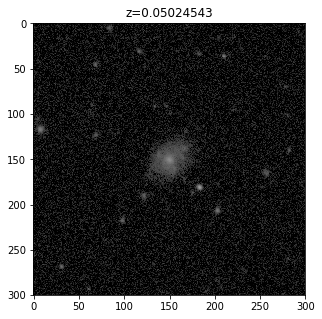

Image 92
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007    HBeta     HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ----------- ----- ------- ----- -------- --------- -------- ----------- -------- -------- ------------------ ------------ ------------
453742091894286336 GALAXY       -- 0.1209898 30.426267 -0.80424052   403      16 51871 2.664029 -3.989498 3.956228 0.007029811 1.886541 7.887724 11.137801221437499 187851463259         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


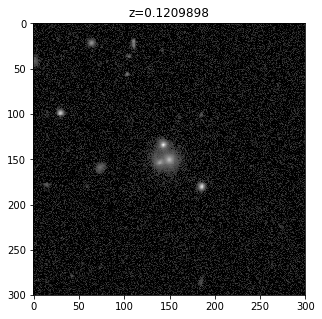

Image 93
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD       OII3726      OIII4959 OIII5007       HBeta         HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ----------------- -------- -------- ------------------ -------- -------- ---------------- ------------ ------------
790455163545479168 GALAXY STARFORMING 0.06405044 31.616292 -0.65106288   702     267 52178 58.49936999999999 14.66904 43.85869 32.149159999999995 86.03194 15.69331 9.96367393603105 321074155657         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


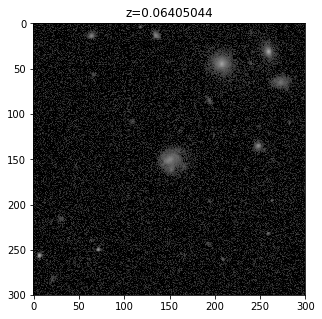

Image 94
Retrieving images...
done!
     specObjID      class  subClass     z        ra      dec   plate fiberID  MJD   OII3726   OIII4959      OIII5007       HBeta    HAlpha   NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- -------- ------- ----- ------- ----- --------- --------- ------------------ -------- -------- --------- ---------------- ------------ ------------
1208169534444300288 GALAXY       -- 0.1759961 32.72658 -1.1569  1073     287 52649 -3.297303 -9.341318 15.615470000000002 9.310905 13.21447 0.5683528 11.5076368102715 204185522260         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


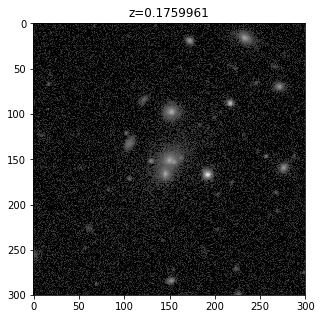

Image 95
Retrieving images...
Exception: 'NoneType' object is not subscriptable
Image 96
Retrieving images...
done!
     specObjID      class   subClass     z              ra           dec    plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta         HAlpha       NII6584        logM        galaxy_id   file_created
------------------- ------ --------- ---------- ------------------ -------- ----- ------- ----- ------- -------- -------- -------- ------------------ -------- ---------------- ------------ ------------
1696830453668931584 GALAXY STARBURST 0.02299949 33.001740000000005 1.225667  1507     361 53763     0.0 1421.382 4340.399 903.3118 3137.8140000000008 201.5405 9.39191422681298 279506973332         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


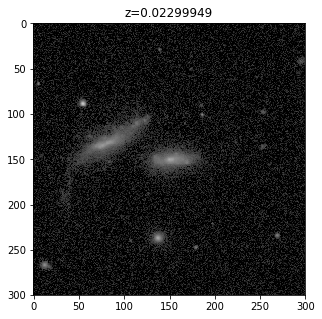

Image 97
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007       HBeta        HAlpha NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- ----------------- ------- -------- ---------------- ------------ ------------
457246510413801472 GALAXY STARFORMING 0.05813542 35.778135 0.21133974   406     477 51876 94.68357 22.33348 73.99213 57.26893000000001 184.773 33.56494 10.0350456670205 146531906617         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 98
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class   subClass     z         ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- --------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
457283893809145856 GALAXY STARBURST 0.1286938 37.082577 0.88956003   406     613 51876 42.83622 6.057484 19.55935 76.81729 382.8832 142.8147 11.0122201856021 325581884359         True


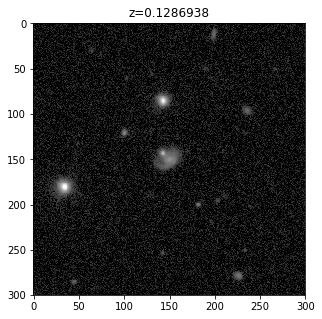

Image 99
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- ------- ---------------- ------------ ------------
458297092834617344 GALAXY       -- 0.08539256 37.176074 -0.84650462   407     203 51820 11.54527 2.267902 19.47599 8.743411 42.35981 31.5379 11.2813546691468 666666643538         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


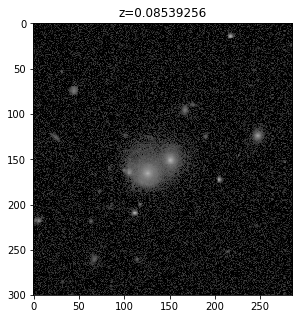

Image 100
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ----------------- ------------ ------------
458268505532295168 GALAXY STARFORMING 0.04061754 37.861032 -0.79292493   407      99 51820 93.13586 20.18629 52.39045 44.88852 122.1541 20.10768 9.540666433391731 299657808058         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


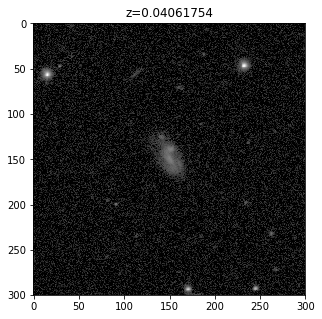

Image 101
Retrieving images...
done!
     specObjID      class    subClass      z        ra          dec         plate fiberID  MJD       OII3726      OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ ----------- --------- ------- ------------------ ----- ------- ----- ----------------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1204830591535572992 GALAXY STARFORMING 0.1270826 39.4129 0.6492600000000001  1070     428 52591 53.85149000000001 5.137045 15.56253 41.79366 205.1168 90.65609 11.072603702595101 102605857676         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


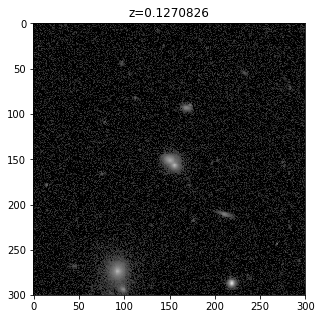

Image 102
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta         HAlpha      NII6584         logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- ----------------- -------- ----------------- ------------ ------------
459424642025678848 GALAXY STARFORMING 0.03923361 39.637212 -0.86745592   408     209 51821 27.44806 2.684455 8.981521 16.28911 66.67163000000001 21.43512 9.951788210891813 140548369067         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


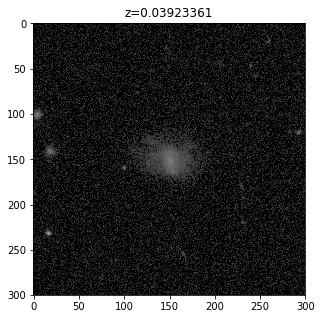

Image 103
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- ------- -------- ---------------- ------------ ------------
459391381798938624 GALAXY STARFORMING 0.03812353 40.303937 -0.87690297   408      88 51821 39.68387 6.704451  16.8648 24.42749 81.7103 21.58892 9.68924798702367 324928489995         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


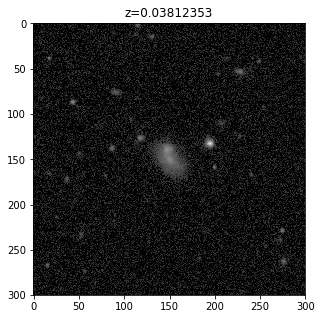

Image 104
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959      OIII5007      HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- ----------------- -------- -------- -------- ----------------- ------------ ------------
459541190258223104 GALAXY STARFORMING 0.02821868 40.888301 0.54593898   408     633 51821 70.23785 12.67485 42.69159000000001 31.58057 103.7799 18.37991 9.522247578589528 174299492670         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


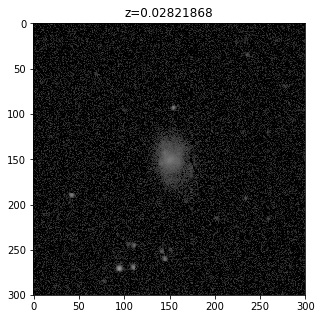

Image 105
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- -------- --------- -------- -------- -------- -------- ------------------ ------------ ------------
796139913522210816 GALAXY       -- 0.1842289 41.358886 0.24373407   707     468 52177 16.49089 -3.399922 10.67265 1.199072 14.52533 3.173901 11.344306155787999 821369087069         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


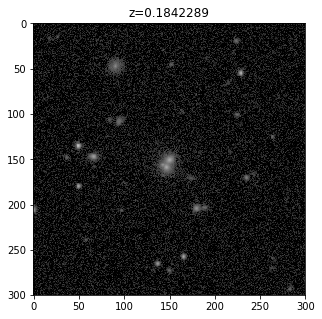

Image 106
Retrieving images...
done!
    specObjID      class   subClass     z          ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- --------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
796049478690826240 GALAXY STARBURST 0.02853504 41.795164 -1.042561   707     139 52177 258.5468  150.861 443.2818 188.0078 606.5667 64.43564 9.36123929246565 127460517229         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


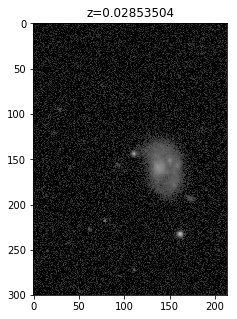

Skpping image 127460517229 (repeat)
Image 108
Retrieving images...
done!
    specObjID      class   subClass     z         ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- -------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
796150633760581632 GALAXY STARBURST 0.07518941 41.90217 0.45114797   707     507 52177 390.8182 210.2139 640.2287 311.3173 1059.174 149.1052 10.0879635738091 192232721794         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


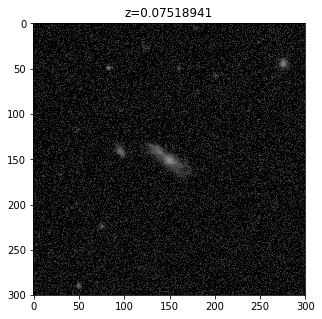

Image 109
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
460512884498130944 GALAXY       -- 0.04325977 42.751725 -0.45411192   409      72 51871 14.39458 8.114597 11.89812 9.950468 30.77586 2.412302 9.48907342195471 211762445673         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


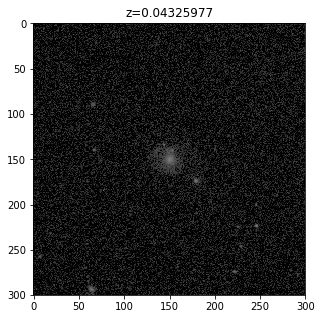

Image 110
Retrieving images...
done!
    specObjID      class   subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959      OIII5007       HBeta         HAlpha      NII6584       logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ----------- ----- ------- ----- -------- -------- ------------------ -------- ----------------- ------- ---------------- ------------ ------------
460502164259760128 GALAXY STARBURST 0.02730209 43.355432 -0.23251502   409      33 51871 1085.393  1471.98 4290.5059999999985 1127.255 3483.774000000001 188.421 9.24271454442808 219856476775         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


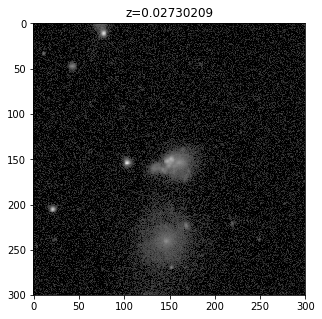

Image 111
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z          ra       dec     plate fiberID  MJD       OII3726      OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ---------- ----- ------- ----- ----------------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
461742413476554752 GALAXY       -- 0.06687158 43.694767 0.98922227   410     449 51877 8.956724000000003 1.766364 3.411936 14.61117 52.08826 17.66752 10.9273789368611 173640103483         True


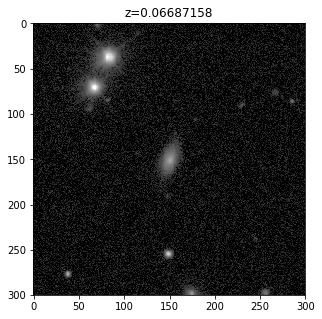

Image 112
Retrieving images...
done!
     specObjID      class    subClass      z          ra       dec    plate fiberID  MJD  OII3726  OIII4959      OIII5007       HBeta    HAlpha  NII6584        logM       galaxy_id   file_created
------------------- ------ ----------- ---------- --------- --------- ----- ------- ----- -------- -------- ------------------ -------- -------- -------- --------------- ------------ ------------
1702402778246178816 GALAXY STARFORMING 0.02889183 44.169167 -0.248029  1512     153 53742 12.63868 3.245201 6.9761690000000005 20.96936 77.33118 22.20755 7.0448300934655 799638451578         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 113
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
    specObjID      class   subClass          z              ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta   HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ --------- ------------------- --------- ----------- ----- ------- ----- -------- -------- -------- ------- -------- -------- ------------------ ------------ ------------
462813886551189504 GALAXY STARBURST 0.18328870000000005 45.474243 -0.76265578   411     251 51817 26.30982 6.445604 14.27842 57.6135 249.9335 85.31844 10.766572713389301 108603715485         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


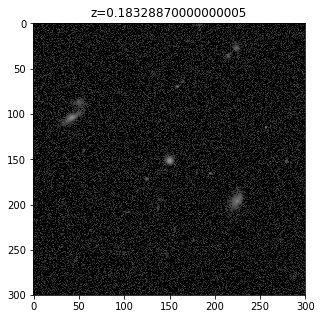

Image 114
Retrieving images...
done!
    specObjID      class    subClass      z              ra                dec          plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta         HAlpha      NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- ----------------- -------------------- ----- ------- ----- -------- -------- -------- -------- ----------------- -------- ---------------- ------------ ------------
462783924859332608 GALAXY STARFORMING 0.02309927 46.14474000000001 -0.08665018699999999   411     142 51817 38.97497 8.518751 23.66741 20.00271 61.46268000000001 13.10362 9.29074450866326 183693158167         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


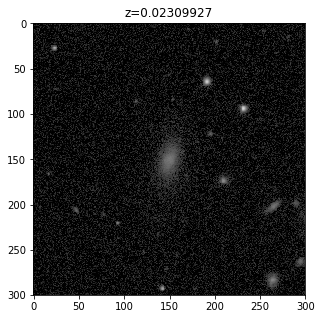

Image 115
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta         HAlpha       NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- ------------------ -------- ---------------- ------------ ------------
799480505161508864 GALAXY       -- 0.1181857 46.362938 0.86304776   710     333 52203 14.52312 5.996544 11.60063 10.31696 26.365820000000006 20.45777 11.3992570591454 172322024115         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


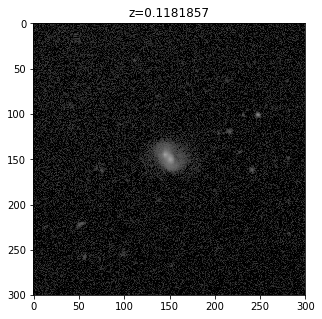

Image 116
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD   OII3726   OIII4959      OIII5007       HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ----------- ----- ------- ----- --------- --------- ------------------ -------- -------- -------- ------------------ ------------ ------------
463953537752131584 GALAXY       -- 0.1080144 46.479916 -0.16077167   412     301 52258 -6.480848 -2.014439 0.4988877000000001 0.343206 3.690259 2.881021 11.102485394672401 304132153700         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


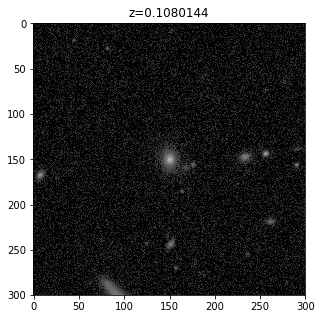

Image 117
Retrieving images...
done!
     specObjID      class    subClass      z         ra      dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha NII6584         logM         galaxy_id   file_created
------------------- ------ ----------- --------- --------- -------- ----- ------- ----- -------- -------- -------- -------- ------- -------- ------------------ ------------ ------------
1704716137104697344 GALAXY STARFORMING 0.1559392 47.077343 0.787032  1514     377 52931 12.13527 5.541815 18.20311 10.29477 63.0139 43.52995 11.402258137373801 115023469501         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


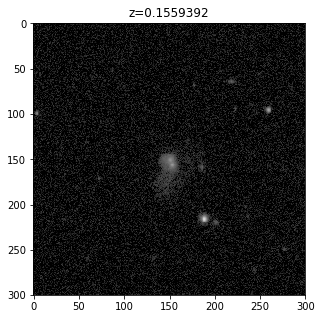

Image 118
Retrieving images...
done!
    specObjID      class   subClass     z         ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- --------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
463929623374227456 GALAXY BROADLINE 0.0392907 47.320741 -0.90666209   412     214 52258 91.97323 13.41315 90.86649 46.18444 130.1773 140.9309 11.1319913230848 215190921132         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 119
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z          ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- --------- --------- ----- ------- ----- -------- -------- -------- -------- -------- ------- ----------------- ------------ ------------
1704647417627961344 GALAXY STARFORMING 0.02732402 47.888664 -1.244449  1514     127 52931 71.75986 34.42239 92.41142 70.87907 204.5609 24.2128 9.143770362962778 326043332640         True


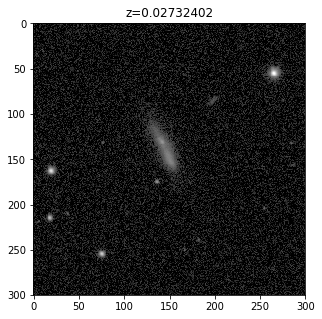

Image 120
Retrieving images...
done!
    specObjID      class  subClass     z        ra       dec     plate fiberID  MJD  OII3726        OIII4959           OIII5007       HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- -------- ---------- ----- ------- ----- -------- ------------------- ------------------ -------- -------- -------- ---------------- ------------ ------------
799390345208031232 GALAXY       -- 0.1696318 48.16195 -1.0575582   710       5 52203 19.10206 -0.3328064000000001 3.4997620000000005 8.978354 17.69472 6.109523 11.2935506113769 127314791955         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


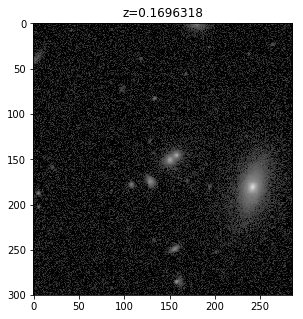

Image 121
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM       galaxy_id   file_created
------------------ ------ -------- --------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- --------------- ------------ ------------
465062387897100288 GALAXY       -- 0.1983806 49.050835 -0.40763802   413     239 51821 12.67451 4.266874 9.406169 16.63382 41.35144 21.17924 11.518521940182 744934310609         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


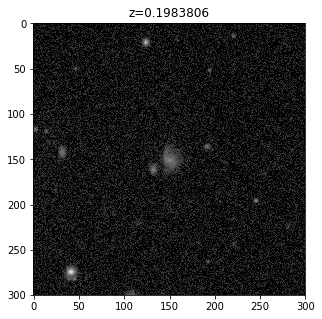

Image 122
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z        ra      dec   plate fiberID  MJD   OII3726   OIII4959 OIII5007  HBeta    HAlpha       NII6584             logM         galaxy_id   file_created
------------------- ------ -------- --------- -------- ------- ----- ------- ----- --------- --------- -------- -------- -------- ----------------- ------------------ ------------ ------------
1199202741184915456 GALAXY       -- 0.1163433 49.30305 0.11263  1065     434 52586 -14.56149 -1.010816  2.36742 1.121677 3.815641 38.56294000000001 10.459817880998699 199987966734         True


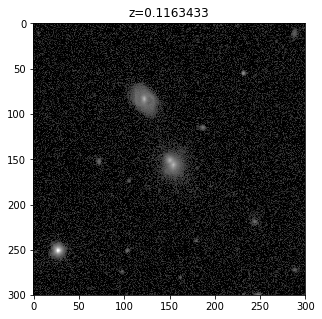

Image 123
Retrieving images...
done!
     specObjID      class    subClass      z        ra       dec    plate fiberID  MJD       OII3726       OIII4959 OIII5007       HBeta         HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- --------- -------- --------- ----- ------- ----- ------------------ -------- -------- ------------------ -------- -------- ---------------- ------------ ------------
1705788985592276992 GALAXY STARFORMING 0.1416809 49.39312 -0.264311  1515     184 52932 27.868340000000003 3.975834 11.16166 30.000840000000004 228.8096 121.3855 11.2371389722596 187716466122         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


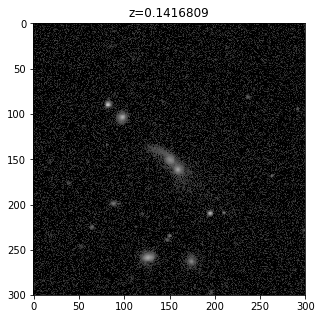

Image 124
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z          ra       dec    plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha  NII6584        logM         galaxy_id   file_created
------------------ ------ -------- ---------- --------- --------- ----- ------- ----- -------- ------------------ -------- -------- -------- ------- ------------------ ------------ ------------
466156127894136832 GALAXY      AGN 0.06688597 51.632393 -1.217991   414     122 51869 53.80195 34.971709999999995  118.983 30.62155 117.9432 107.957 10.627790605881302 287184754902         True


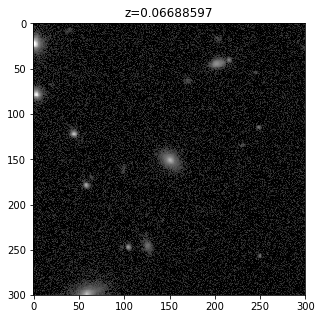

Image 125
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959  OIII5007  HBeta    HAlpha   NII6584         logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- -------- --------- -------- -------- --------- ----------------- ------------ ------------
466156402772043776 GALAXY       -- 0.03642312 51.648513 -0.81994994   414     123 51869 2.438732 2.316809 -1.011818 1.715521 1.753168 -0.958003 9.810135204222439 298880826340         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


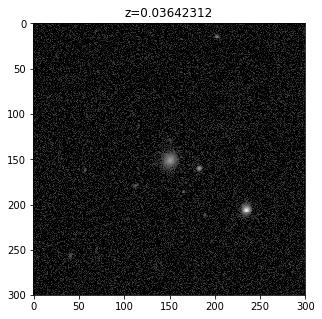

Image 126
Retrieving images...
done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726   OIII4959  OIII5007  HBeta    HAlpha  NII6584        logM       galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- -------- ---------- -------- -------- -------- -------- --------------- ------------ ------------
467303467287865344 GALAXY       -- 0.08499639 53.344439 -0.15208592   415     200 51810 13.89833 -0.5428782 3.479593 2.731781 13.07339 10.28625 10.709807040193 594070556293         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


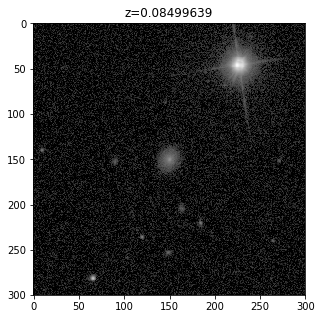

Image 127
Retrieving images...
done!
    specObjID      class    subClass      z          ra         dec      plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ------------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
468380988699863040 GALAXY STARFORMING 0.03617334 56.449928 -0.0071165197   416      24 51811 281.324 267.9328 841.4302 453.7947 1987.244 1518.786 10.5248692637875 330509370012         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 128
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class  subClass    z         ra     dec   plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- -------- --------- ------ ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1721556532056844288 GALAXY       -- 0.139245 57.159378 -0.469  1529     202 52930 35.30885  6.22481 19.70605 17.23939 81.44601 51.73074 11.3666863823737 119451294450         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


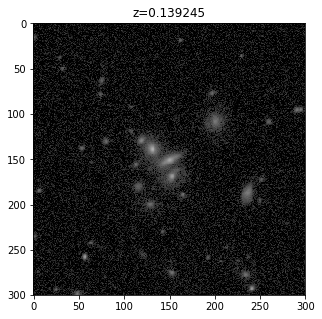

Image 129
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z          ra      dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta   HAlpha NII6584         logM        galaxy_id   file_created
------------------- ------ -------- ---------- --------- -------- ----- ------- ----- ------- --------- -------- -------- ------ -------- ----------------- ------------ ------------
1721618929341720576 GALAXY       -- 0.01375321 57.248852 1.171386  1529     429 52930     0.0 -3.198107 14.19956 14.55273 42.112 8.226291 9.467479214585019 933149938019         True


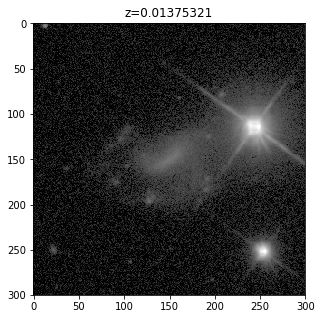

Image 130
Retrieving images...
done!
     specObjID      class   subClass     z         ra           dec         plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- --------- --------- ------------------ ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1721617005196371968 GALAXY STARBURST 0.0137097 57.283871 1.1644139999999998  1529     422 52930     0.0 261.9621 815.5405 333.1768 1002.599 103.1186 9.20164721471723 594172616027         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


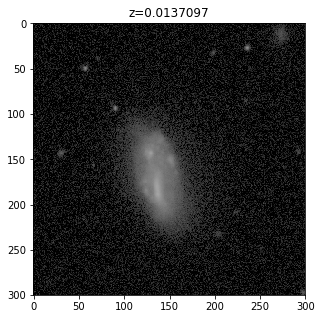

Image 131
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class   subClass     z         ra      dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- ---------- -------- -------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1257694565775730688 GALAXY STARBURST 0.07841583 309.7023 -0.22637  1117     234 52885 429.2838 98.89053 282.5724 642.7031 2897.423 1238.086 11.0510632987819 305182102285         True


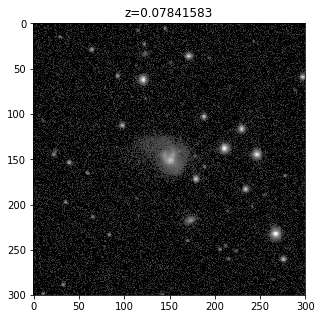

Image 132
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1106852008389797888 GALAXY STARFORMING 0.05860396 312.35309 0.90689593   983     336 52443 136.8046 28.28299 91.41154 104.9599 572.1282 282.7512 10.900840651166199 335975472665         True


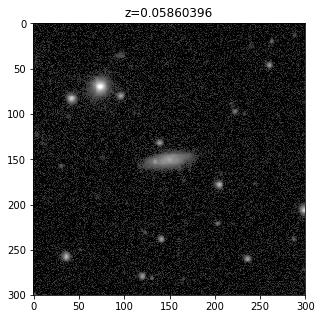

Image 133
Retrieving images...
done!
     specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1106789611104921600 GALAXY STARFORMING 0.02993406 313.62688 -0.13913079   983     109 52443 249.0002 41.60126 135.9916 159.4735 530.2671 131.1604 9.83160178969365 208885774885         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


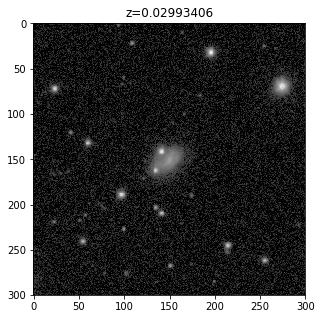

Image 134
Retrieving images...
done!
     specObjID      class   subClass          z               ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha       NII6584              logM         galaxy_id   file_created
------------------- ------ --------- -------------------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- ------------------ ------------------ ------------ ------------
1106787686959572992 GALAXY STARBURST 0.053935300000000005 313.83986 -0.4135969   983     102 52443 389.1815 100.4663 300.6974 243.6258 857.1979 161.17700000000005 10.070017488963302 383241749318         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 135
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class  subClass          z              ra        dec     plate fiberID  MJD   OII3726   OIII4959  OIII5007  HBeta    HAlpha   NII6584         logM         galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ----------- ----- ------- ----- --------- --------- --------- -------- -------- --------- ------------------ ------------ ------------
1107959766338004992 GALAXY       -- 0.16102139999999998 313.84397 -0.21567006   984     270 52442 -2.921211 0.5868384 -3.145225 2.777259 1.719148 -2.504817 11.322639788478199 229363398912         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 136
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class  subClass     z         ra            dec         plate fiberID  MJD   OII3726    OIII4959   OIII5007   HBeta         HAlpha       NII6584       logM        galaxy_id   file_created
------------------- ------ -------- --------- --------- ------------------- ----- ------- ----- ---------- --------- ----------- -------- ------------------ ------- ---------------- ------------ ------------
1106898462756071424 GALAXY       -- 0.1760007 313.88698 0.08226390900000001   983     505 52443 -0.5923653 -1.582652 -0.08375362 9.177752 4.5662650000000005 2.52705 11.4977887107129 337487957052         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


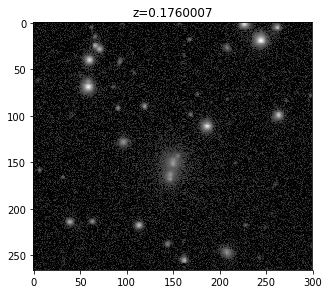

Image 137
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta   HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- --------- --------- ---------- ----- ------- ----- -------- --------- -------- ------- -------- -------- ------------------ ------------ ------------
1107976259012421632 GALAXY       -- 0.1589779 313.96516 0.89644997   984     330 52442 2.983414 -3.223647  15.1947 11.5236 22.06444 29.16436 11.268735813668599 299996645709         True


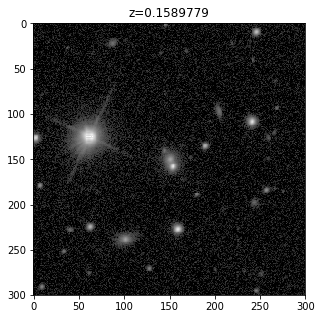

Image 138
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class   subClass     z         ra        dec     plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------- ------ --------- --------- --------- ----------- ----- ------- ----- -------- ------------------ -------- -------- -------- -------- ----------------- ------------ ------------
1151825063914268672 GALAXY STARBURST 0.1052657 313.97955 -0.38000929  1023     107 52818 100.9711 60.348180000000006 166.9989 87.07244 284.0529 55.07619 9.811521031712509 611762848976         True


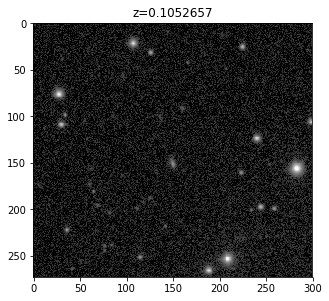

Image 139
Retrieving images...
done!
     specObjID      class  subClass          z              ra        dec      plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ------------ ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1107958391948470272 GALAXY       -- 0.13623020000000002 314.05694 -0.091396335   984     265 52442 6.198127 0.161368 8.947563 10.49559 21.88565 11.48136 11.6043778190001 149080286350         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


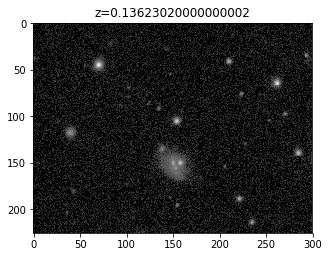

Image 140
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z          ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- ---------- --------- --------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1107986979250792448 GALAXY       -- 0.06052183 314.28493 1.1347642   984     369 52442 36.40688 10.90941 26.89742 39.99573 154.9967 108.6358 10.939359419119699 214079870554         True


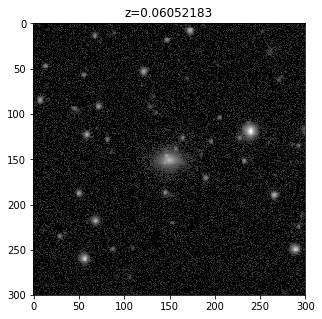

Image 141
Retrieving images...
done!
     specObjID      class  subClass     z         ra       dec    plate fiberID  MJD  OII3726   OIII4959      OIII5007       HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------- ------ -------- --------- --------- --------- ----- ------- ----- -------- --------- ------------------ -------- -------- ------- ---------------- ------------ ------------
1107985329983350784 GALAXY       -- 0.1345905 314.34099 1.1078274   984     363 52442 27.51113 -6.668166 4.6357610000000005 7.267034 36.11336 29.1534 11.4536301940907 113010056683         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


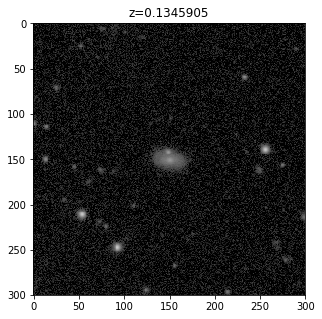

Image 142
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z        ra      dec     plate fiberID  MJD  OII3726 OIII4959      OIII5007      HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ ----------- --------- ------- ---------- ----- ------- ----- ------- -------- ----------------- -------- -------- -------- ------------------ ------------ ------------
1109090338984716288 GALAXY STARFORMING 0.0645438 315.903 -1.2285646   985     287 52431 80.6043 19.88178 62.38308000000001 48.43876 158.3462 30.69232 10.039219930207803 166873270631         True


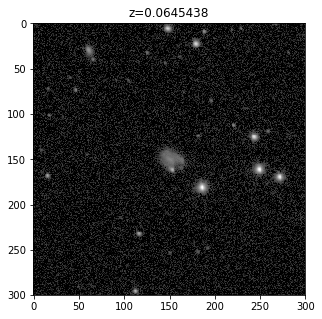

Image 143
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass          z              ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1109110679949830144 GALAXY       -- 0.16768110000000006 316.18304 0.93134243   985     361 52431 2.826076 2.996542 1.411721 3.779061 6.653337 2.397042 11.438531516993198 275156335536         True


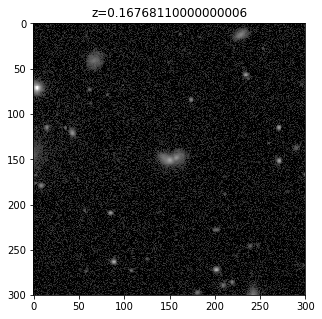

Image 144
Retrieving images...
done!
     specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726        OIII4959      OIII5007  HBeta   HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- ---------- --------- ----------- ----- ------- ----- -------- ------------------- -------- ------- -------- -------- ---------------- ------------ ------------
1109048282664953856 GALAXY       -- 0.09651325 316.70744 -0.85736543   985     134 52431 27.07683 -1.7155669999999998 12.54501 26.0227 44.58988 33.34345 11.2220297275251 331635874580         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 145
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z        ra       dec     plate fiberID  MJD   OII3726        OIII4959           OIII5007           HBeta        HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- -------- ---------- ----- ------- ----- --------- ------------------- ----------------- ----------------- -------- -------- ---------------- ------------ ------------
1109044984130070528 GALAXY       -- 0.1526991 316.7451 -1.0036838   985     122 52431 -1.945467 -1.4494049999999998 7.804899000000002 6.608263000000001 39.34611 22.22183 11.4853500033056 204649253446         True


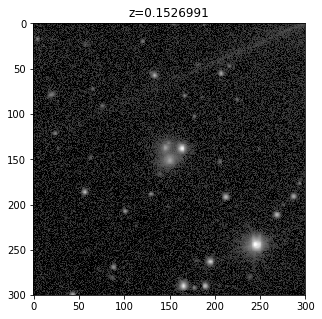

Image 146
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z        ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- -------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1110234106156836864 GALAXY       -- 0.1518655 317.5573 0.99086216   986     352 52443 1.677544 5.088312 11.57072 6.709708 12.90208 12.83171 11.5381285401494 188601172377         True


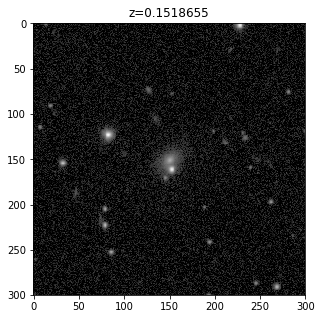

Image 147
Retrieving images...
done!
     specObjID      class   subClass     z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007       HBeta        HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- ----------------- -------- -------- ---------------- ------------ ------------
1109017496339376128 GALAXY STARBURST 0.06095252 317.92962 -0.2488862   985      22 52431 104.6725 34.55397 110.3786 64.19955999999999 210.2455 29.92712 9.80370657856509 230027569941         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


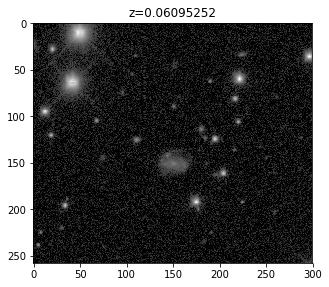

Image 148
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
1155242891447134208 GALAXY STARFORMING 0.06002479 318.19922 -1.0451081  1026     253 52558 114.9568 27.83477 85.16271 97.76623 493.6882 244.8697 10.403681970686598 710676237672         True


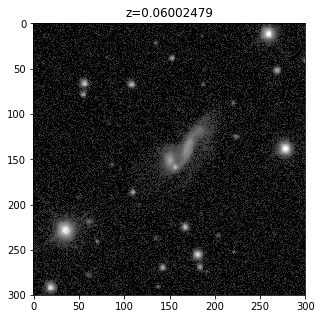

Image 149
Retrieving images...
done!
     specObjID      class    subClass      z         ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha       NII6584             logM         galaxy_id   file_created
------------------- ------ ----------- --------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- -------- ----------------- ------------------ ------------ ------------
1110137624011499520 GALAXY STARFORMING 0.0512129 319.61732 -0.61064026   986       1 52443     0.0 6.579255  21.0888 44.66903 180.2309 81.59680999999998 10.665899599459902 574826715372         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


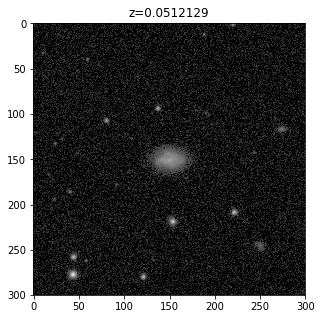

Image 150
Retrieving images...
done!
     specObjID      class   subClass     z          ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- ---------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1111306681091909632 GALAXY STARBURST 0.01949662 320.20438 0.046689728   987     158 52523     0.0 30.89812 94.39792 44.38336 160.0611 16.62818 7.17008324091467 585720093325         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


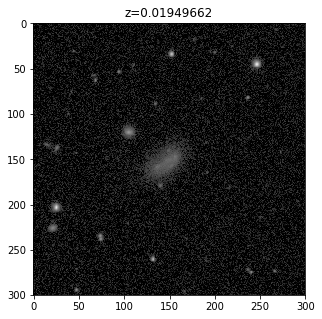

Image 151
Retrieving images...
done!
     specObjID      class   subClass     z          ra       dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- ---------- --------- --------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1111394642022131712 GALAXY STARBURST 0.08627404 320.54331 0.3914668   987     478 52523 131.1031 22.95888 70.32334 109.8592 373.0205 106.8237 10.3552852962158 303244418176         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


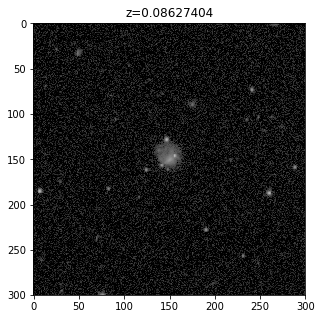

Image 152
Retrieving images...
done!
     specObjID      class  subClass     z          ra       dec     plate fiberID  MJD       OII3726      OIII4959      OIII5007       HBeta    HAlpha      NII6584              logM         galaxy_id   file_created
------------------- ------ -------- ---------- --------- ---------- ----- ------- ----- ----------------- -------- ------------------ -------- ------- ------------------ ------------------ ------------ ------------
1111300908655863808 GALAXY       -- 0.08703393 320.55069 0.24249912   987     137 52523 7.731416999999999 1.947663 5.7043050000000015 7.725167 33.8439 15.585579999999998 10.709273922521199 215850571907         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


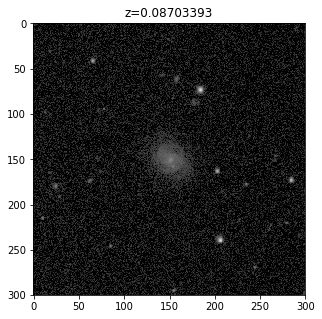

Image 153
Retrieving images...
done!
     specObjID      class  subClass          z              ra       dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ---------- ----- ------- ----- -------- --------- -------- -------- -------- -------- ---------------- ------------ ------------
1111438072731428864 GALAXY       -- 0.13500920000000002 321.44315 0.93110248   987     636 52523 20.08407 -3.903131 25.48786 17.80568 37.90359 26.51759 11.7815503615879 203330922297         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


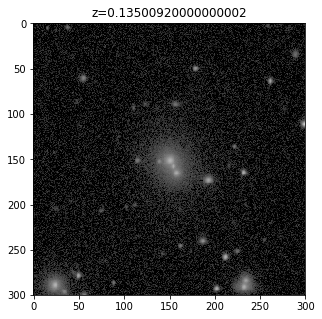

Image 154
Retrieving images...
done!
     specObjID      class  subClass          z              ra       dec     plate fiberID  MJD        OII3726         OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ---------- ----- ------- ----- -------------------- --------- -------- -------- -------- -------- ------------------ ------------ ------------
1112485357506553856 GALAXY       -- 0.14104029999999998 321.45848 0.94010663   988     350 52520 -0.13085750000000002 -1.447863  8.08279 19.31329 18.25986 1.916434 11.222973648169804 423898047732         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


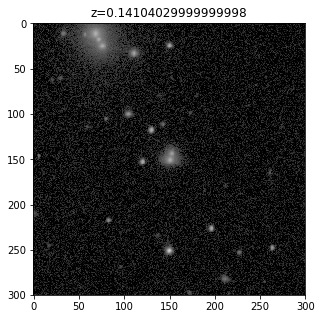

Image 155
Retrieving images...
done!
     specObjID      class  subClass     z             ra           dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007   HBeta     HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- --------- ----------------- ---------- ----- ------- ----- ------- -------- -------- --------- --------- -------- ------------------ ------------ ------------
1112474362390276096 GALAXY       -- 0.2234196 321.6379100000001 -1.1228035   988     310 52520 6.89355 1.433883 1.358712 -19.07879 -1.009784 10.12107 11.513085126453301 729917175882         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


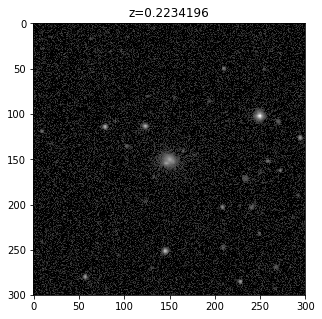

Image 156
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass           z                  ra             dec      plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ------------------- ----------------- ------------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1112460068739115008 GALAXY STARFORMING 0.13299520000000006 321.6485600000001 -0.0023632001   988     258 52520 15.04204 3.641596 6.380458 48.90522 232.7635 78.75658 10.8869760753174 308811932591         True


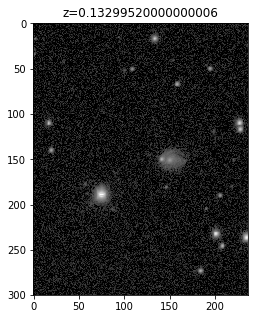

Image 157
Retrieving images...
done!
     specObjID      class  subClass          z              ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1112435329727490048 GALAXY       -- 0.13834649999999998 322.35954 0.090530788   988     168 52520 22.10381 3.895234 11.80077 21.91191 52.48658 75.77436 11.6996046936796 291676013356         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


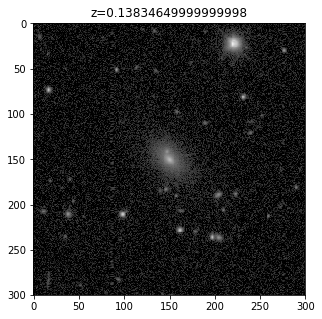

Image 158
Retrieving images...
done!
     specObjID      class  subClass     z         ra        dec     plate fiberID  MJD   OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- --------- ----------- ----- ------- ----- ---------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1112432855826327552 GALAXY       -- 0.1360651 322.45018 -0.14317493   988     159 52520 -0.2616139 2.454046 2.027446 6.867789 49.16667 34.86354 11.0373140407054 782554532507         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 159
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


done!
     specObjID      class    subClass      z         ra        dec     plate fiberID  MJD       OII3726            OIII4959     OIII5007       HBeta        HAlpha  NII6584       logM       galaxy_id   file_created
------------------- ------ ----------- --------- --------- ----------- ----- ------- ----- ------------------ ----------------- -------- ----------------- -------- -------- -------------- ------------ ------------
1113593389477029888 GALAXY STARFORMING 0.1033825 322.82416 -0.87268611   989     285 52468 34.081509999999994 8.243196000000001 17.14201 35.25069000000001 107.0575 34.67536 10.42400237154 271580408129         True
Exception: zero-size array to reduction operation minimum which has no identity
Image 160
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class   subClass     z         ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ --------- --------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1113576896802613248 GALAXY STARBURST 0.0312197 323.21669 -0.31125654   989     225 52468 175.921 42.29002 132.1998 126.7821 394.1497 78.76794 9.76424917347831 172238061221         True


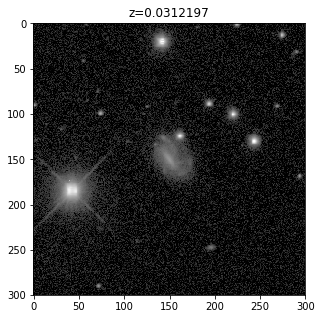

Image 161
Retrieving images...
done!
     specObjID      class  subClass     z          ra       dec    plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------- ------ -------- ---------- --------- --------- ----- ------- ----- -------- --------- -------- -------- -------- ------- ---------------- ------------ ------------
1112564247465846784 GALAXY       -- 0.08601508 323.40753 1.0709406   988     637 52520 25.84862 0.7378507 9.754365 13.59648 27.71207 5.77491 11.2892072735801 106641606635         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


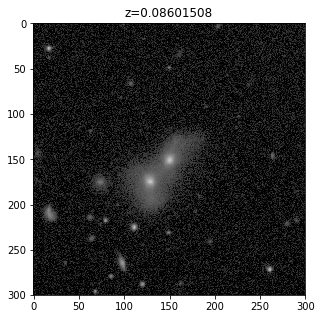

Image 162
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1113619777756096512 GALAXY STARFORMING 0.06285027 323.55117 0.41472602   989     381 52468 213.8607 136.0857 406.6779 170.8194 597.3826 116.0226 9.90748784850213 304479632979         True


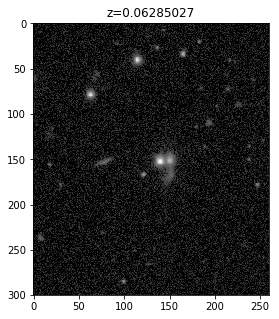

Image 163
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z         ra       dec     plate fiberID  MJD        OII3726       OIII4959 OIII5007  HBeta    HAlpha       NII6584             logM        galaxy_id   file_created
------------------- ------ -------- --------- --------- ---------- ----- ------- ----- ------------------- -------- -------- -------- -------- ------------------ ---------------- ------------ ------------
1158692065362601984 GALAXY       -- 0.1565711 324.34979 0.34622586  1029     513 52912 -1.7546400000000002 2.464482 1.278636 2.227335 13.00892 4.8679489999999985 11.0499443673502 347559435816         True


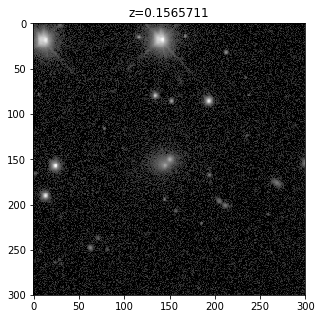

Image 164
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass     z        ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007   HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- --------- -------- ----------- ----- ------- ----- -------- -------- -------- --------- -------- -------- ---------------- ------------ ------------
1114723962257958912 GALAXY       -- 0.2105156 324.5213 -0.50236101   990     302 52465 26.26627 1.094794 9.490037 0.5440505 43.20681 21.51746 11.7271302534322 250307715410         True


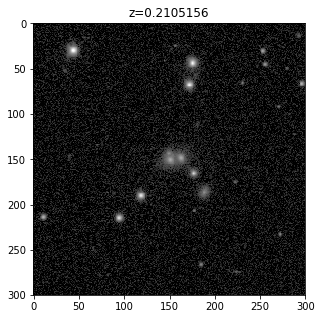

Image 165
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class    subClass           z              ra            dec         plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584       logM        galaxy_id   file_created
------------------- ------ ----------- ------------------- --------- ------------------- ----- ------- ----- -------- -------- -------- -------- -------- ------- ---------------- ------------ ------------
1158565346647500800 GALAXY STARFORMING 0.13620339999999995 324.56033 -0.7832213000000001  1029      52 52912 39.15007 11.09579 27.12723 63.41087 235.1983 83.9248 10.0522017709479 147365285547         True


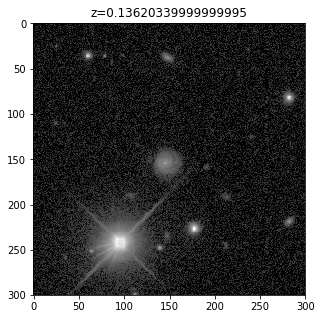

Image 166
Retrieving images...
done!
     specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1114759421507954688 GALAXY STARFORMING 0.04987694 324.98645 0.32325996   990     431 52465 114.9776 37.32573 100.6424 93.77438 278.2427 64.04977 9.99331542697075 302674062556         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


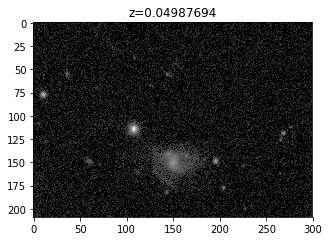

Image 167
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass          z                  ra          dec   plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- ------------------- ----------------- ------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1247612049886832640 GALAXY       -- 0.13267679999999998 325.8289200000001 0.99469  1108     418 53227 13.57377 4.491521 9.528616 2.428487 5.826247 12.22024 11.3415958556631 338280023116         True


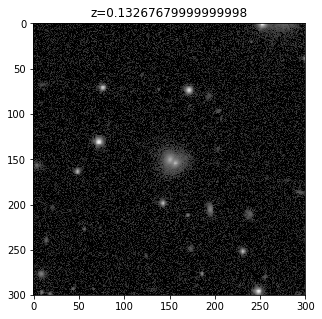

Image 168
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass    z         ra      dec   plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta         HAlpha      NII6584        logM        galaxy_id   file_created
------------------- ------ -------- -------- --------- ------- ----- ------- ----- -------- --------- -------- -------- ----------------- -------- ---------------- ------------ ------------
1246458657843996672 GALAXY       -- 0.130462 326.95709 -0.5337  1107     318 52968 62.94534 -13.21418 8.419573 16.75979 35.98050999999999 13.07876 11.1833401618892 307765593042         True


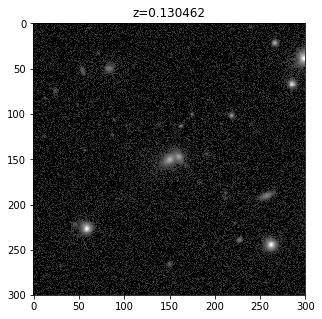

Image 169
Retrieving images...
done!
    specObjID      class  subClass     z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ---------- ----- ------- ----- ------- --------- -------- -------- -------- -------- ---------------- ------------ ------------
418930734191896576 GALAXY       -- 0.07386184 328.42818 0.47283437   372     349 52173 36.2101 -2.347605 17.05116 10.33528 35.29681 37.48955 11.0621364578136 249054598439         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


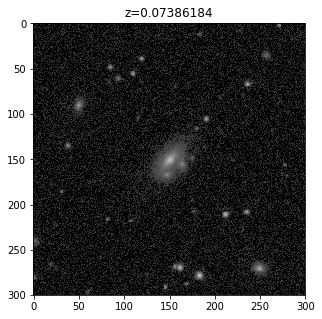

Image 170
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- ----------- ----- ------- ----- ------- --------- -------- -------- -------- -------- ----------------- ------------ ------------
418894175430273024 GALAXY       -- 0.01624549 329.60401 -0.73965985   372     216 52173     0.0 0.1466585 4.802423 9.246984 17.55702 4.776706 9.834115787947779 726013251293         True


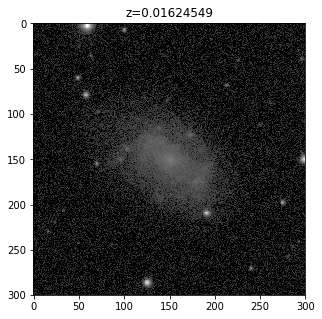

Image 171
Retrieving images...
done!
    specObjID      class  subClass    z         ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta   HAlpha       NII6584            logM        galaxy_id   file_created
------------------ ------ -------- -------- --------- ---------- ----- ------- ----- -------- -------- -------- ------- -------- ----------------- ---------------- ------------ ------------
418846346674464768 GALAXY       -- 0.100766 330.46863 -1.1706717   372      42 52173 32.62078  4.39727 20.47614 16.4571 56.77299 43.04877000000001 10.8360034641889 883637971103         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


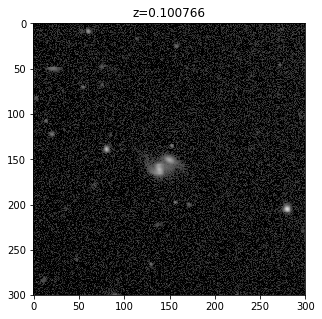

Image 172
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha       NII6584             logM         galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- ----------------- ------------------ ------------ ------------
419000003424446464 GALAXY STARFORMING 0.09172707 330.66285 0.92507421   372     601 52173 32.78137 8.448306 16.33105 51.74788 234.2956 79.80658000000003 10.485248421676099 167423936091         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


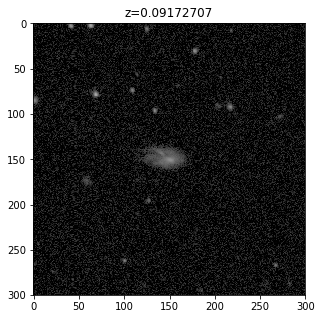

Image 173
Retrieving images...
done!
    specObjID      class  subClass     z         ra        dec      plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha       NII6584             logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ------------ ----- ------- ----- -------- ------------------ -------- -------- -------- ----------------- ------------------ ------------ ------------
420014571319748608 GALAXY       -- 0.1535275 331.55737 -0.062593896   373     196 51788 5.675693 6.9100990000000015 10.04738 40.64649 205.3035 79.36055999999998 11.312325655875304 227989905112         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


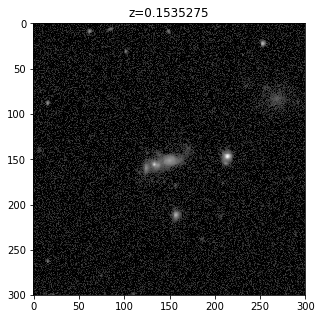

Image 174
Retrieving images...
done!
     specObjID      class    subClass      z              ra          dec   plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- ----------------- ------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1660832978302953472 GALAXY STARFORMING 0.04656953 331.6457200000001 0.05768  1475     475 52903 172.8998  35.7393 85.25508 91.14311 403.3127 313.0416 10.8812996929279 177588299313         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


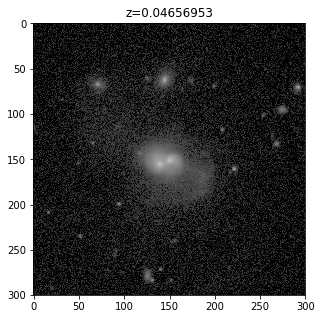

Skpping image 177588299313 (repeat)
Image 176
Retrieving images...
done!
     specObjID      class   subClass     z          ra      dec   plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM       galaxy_id   file_created
------------------- ------ --------- ---------- --------- ------- ----- ------- ----- -------- -------- -------- -------- -------- -------- --------------- ------------ ------------
1244284647957882880 GALAXY STARBURST 0.05105944 332.47983 1.20724  1105     601 52937 615.6037 219.7655 669.6802 429.1772 1819.293 590.4626 10.345211058012 246527885162         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


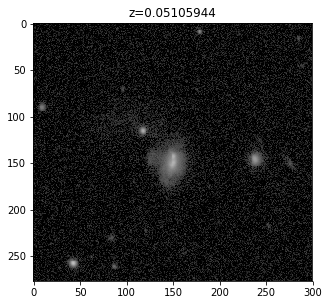

Image 177
Retrieving images...
done!
    specObjID      class    subClass      z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ----------------- ------------ ------------
420134418087176192 GALAXY STARFORMING 0.05721604 332.94774 0.11382869   373     632 51788 24.25361 9.511173 21.78298 27.03995 85.08413 18.07351 9.962430619977141 802392080205         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


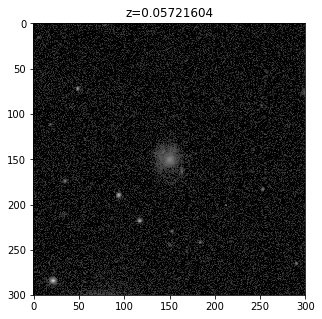

Image 178
Retrieving images...
done!
    specObjID      class    subClass     z         ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- -------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- -------- -------- ------------------ ------------ ------------
421165760044361728 GALAXY STARFORMING 0.093178 332.98709 -0.96809777   374     288 51791 9.12709 4.100528 9.835558 35.39806 122.3087 49.86084 10.997915766495302 156915831380         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


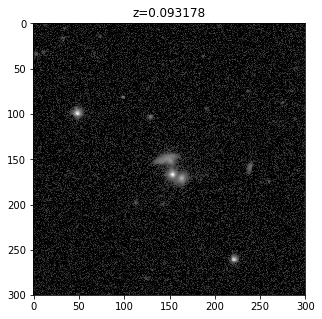

Image 179
Retrieving images...
done!
    specObjID      class   subClass     z          ra      dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha NII6584       logM       galaxy_id   file_created
------------------ ------ --------- ---------- --------- -------- ----- ------- ----- -------- -------- -------- -------- ------- ------- --------------- ------------ ------------
420131394430199808 GALAXY STARBURST 0.05818106 333.08363 0.561454   373     621 51788 138.6588   47.216 141.9702 101.7945 405.821  86.087 10.069226579577 267323511257         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


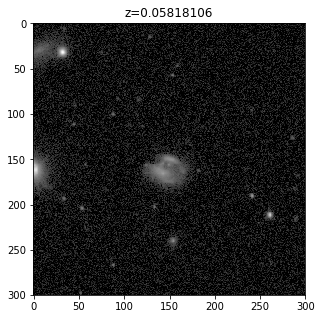

Skpping image 267323511257 (repeat)
Image 181
Retrieving images...
done!
     specObjID      class    subClass      z              ra          dec    plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ ----------- ---------- ----------------- -------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
1661840406855313408 GALAXY STARFORMING 0.07734468 334.1681200000001 -0.96763  1476      44 52964 26.13164 8.050787 29.79185 56.06377 301.7276 112.9446 7.77690722851942 233904064028         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


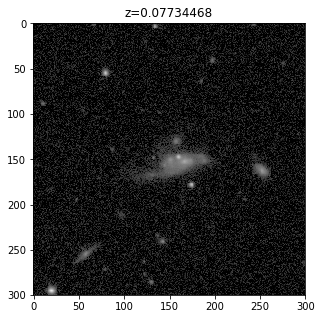

Image 182
Retrieving images...
done!
    specObjID      class   subClass     z          ra       dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ---------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
422302935800637440 GALAXY STARBURST 0.06160219 334.48266 0.78609978   375     329 52140 431.2252 224.3456 671.0181 370.0944 1316.572 186.9978 10.0754254450287 115667330600         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


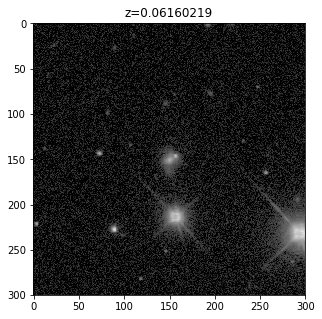

Image 183
Retrieving images...
done!
     specObjID      class  subClass     z         ra      dec   plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------- ------ -------- --------- --------- ------- ----- ------- ----- -------- ------------------ -------- -------- -------- -------- ------------------ ------------ ------------
1241910251523958784 GALAXY       -- 0.1317114 335.79962 0.07147  1103     155 52873 -1.00484 -4.896401999999998 11.80884 14.70549 26.57963 6.756605 11.616213726924698 142589557263         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


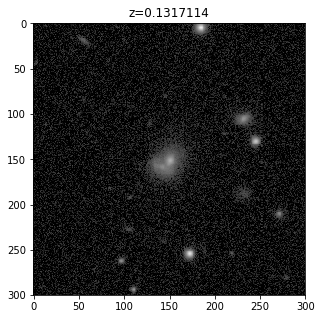

Image 184
Retrieving images...
done!
    specObjID      class  subClass    z        ra       dec     plate fiberID  MJD  OII3726   OIII4959  OIII5007  HBeta    HAlpha  NII6584         logM        galaxy_id   file_created
------------------ ------ -------- -------- ------- ----------- ----- ------- ----- -------- ---------- -------- -------- ------- ---------- ---------------- ------------ ------------
757810663048374272 GALAXY       -- 0.150981 335.992 -0.82239374   673     291 52162 4.887137 -0.1866137 1.306879 1.796191 4.52561 -0.3910073 11.2443184914167 899583591617         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


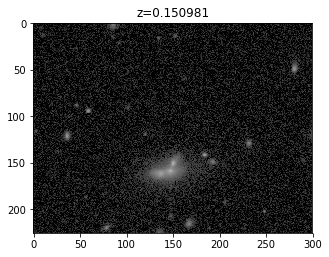

Skpping image 899583591617 (repeat)
Image 186
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
     specObjID      class  subClass          z              ra      dec   plate fiberID  MJD  OII3726   OIII4959  OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------- ------ -------- ------------------- --------- ------- ----- ------- ----- -------- ---------- -------- -------- -------- -------- ---------------- ------------ ------------
1242022676587898880 GALAXY       -- 0.21064210000000005 336.17636 1.00602  1103     564 52873 8.608665 -0.1029116 2.608243 -2.52299 21.32751 20.93003 11.5084200495758 193392106566         True


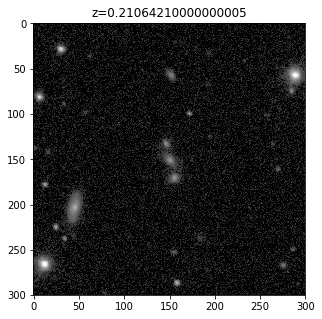

Image 187
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z          ra       dec    plate fiberID  MJD  OII3726   OIII4959 OIII5007   HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- ---------- --------- --------- ----- ------- ----- -------- --------- -------- --------- -------- -------- ------------------ ------------ ------------
757795544763492352 GALAXY       -- 0.05693857 336.83569 -0.679192   673     236 52162 -17.8818 -5.952628 18.18821 0.9074693 17.97289 5.868039 11.518353943222401 295226183188         True


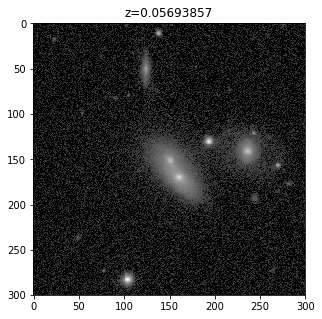

Image 188
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z         ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- --------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
424536593756350464 GALAXY STARFORMING 0.1071677 338.77852 -0.57388258   377     263 52145 24.64899 4.958817 21.73578 41.52858 248.6025 128.4831 11.1262396394349 174910644358         True


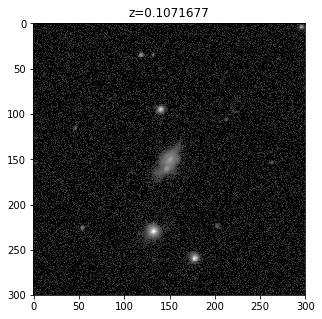

Image 189
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z         ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- --------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
424508831087749120 GALAXY STARFORMING 0.1007937 339.60808 -0.71824086   377     162 52145 65.25027 12.54477  32.8965 78.92445 319.9846 119.4137 10.5083701728407 268332738246         True


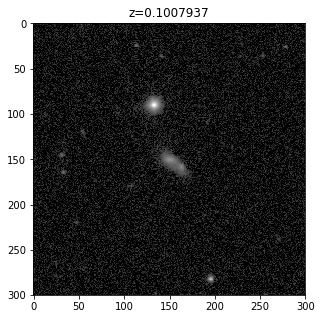

Image 190
Retrieving images...
done!
    specObjID      class  subClass     z        ra      dec    plate fiberID  MJD   OII3726  OIII4959 OIII5007  HBeta         HAlpha      NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- ------- --------- ----- ------- ----- --------- -------- -------- -------- ----------------- -------- ---------------- ------------ ------------
425733412179961856 GALAXY       -- 0.2154165 341.755 1.0750773   378     521 52146 -3.315704  4.29586  3.03767 1.698207 7.835294999999999 3.320154 11.6338667050268 476162680636         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


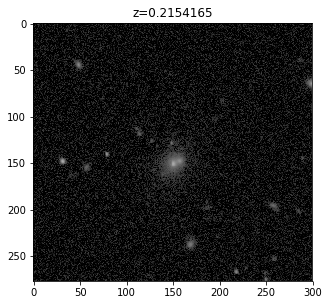

Image 191
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726 OIII4959  OIII5007 HBeta   HAlpha   NII6584        logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- ------- -------- --------- ------ -------- --------- ---------------- ------------ ------------
425747430953216000 GALAXY       -- 0.1460629 342.00919 0.91118421   378     572 52146 4.42216 3.877374 -0.202047 3.4019 1.922492 -0.919387 11.4770409329469 197748641579         True


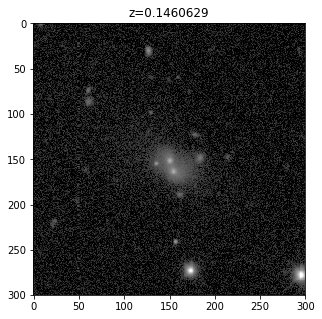

Skpping image 197748641579 (repeat)
Image 193
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass          z             ra            dec         plate fiberID  MJD  OII3726   OIII4959  OIII5007  HBeta    HAlpha  NII6584        logM         galaxy_id   file_created
------------------ ------ -------- ------------------- -------- ------------------- ----- ------- ----- -------- ---------- -------- -------- -------- ------- ------------------ ------------ ------------
426772994434557952 GALAXY       -- 0.16708820000000002 343.3728 -1.2280726999999998   379     207 51789 10.24466 -0.4869566 8.266356 8.895878 23.50623 25.3685 11.627624138371804 318352645353         True


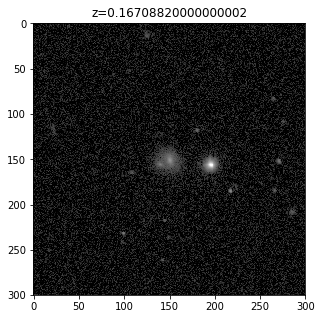

Image 194
Retrieving images...
done!
    specObjID      class  subClass     z             ra            dec      plate fiberID  MJD  OII3726   OIII4959      OIII5007      HBeta         HAlpha       NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- ----------------- ------------ ----- ------- ----- -------- --------- ----------------- -------- ------------------ -------- ------------------ ------------ ------------
762279635508553728 GALAXY       -- 0.1797066 345.0423600000001 -0.092055039   677     165 52606 9.249547 -1.331524 7.688232000000001 2.700508 25.718870000000006 20.34898 11.539344248120699 785758167886         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


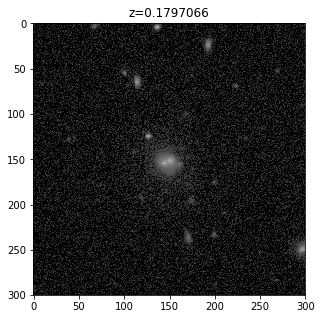

Skpping image 785758167886 (repeat)
Image 196
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726  OIII4959      OIII5007      HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- ------- --------- ----------------- -------- -------- -------- ------------------ ------------ ------------
763518789777123328 GALAXY       -- 0.1177559 347.53361 0.73758598   678     577 52884 10.8822 -1.226579 8.685075999999999 1.563997 20.08769 1.551723 10.497352086946599 817677222685         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


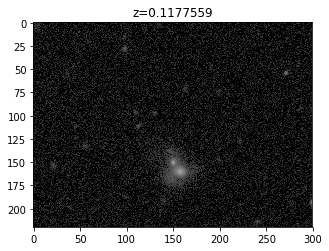

Skpping image 817677222685 (repeat)
Image 198
Retrieving images...
done!
    specObjID      class   subClass     z          ra        dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ----------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
764501191555049472 GALAXY STARBURST 0.02981126 349.37335 -0.85114643   679      55 52177 507.4293 868.8442 2527.269 587.1847 1839.187 64.93771 9.28766646220332 167540542239         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


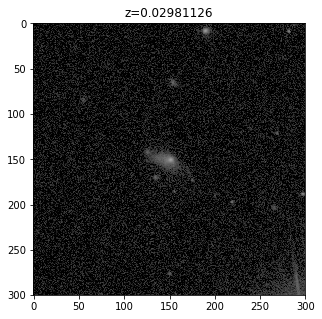

Image 199
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD  OII3726      OIII4959      OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ------- ------------------ -------- -------- -------- -------- ---------------- ------------ ------------
431307655751952384 GALAXY STARFORMING 0.02514403 350.08821 -0.30534861   383     320 51818     0.0 5.9813480000000006 11.12351 17.16131 51.03751 15.04168 9.59280880870455 119819387323         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


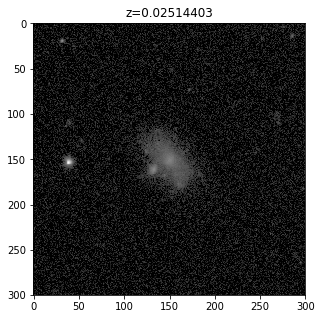

Image 200
Retrieving images...
done!
    specObjID      class   subClass     z          ra        dec     plate fiberID  MJD  OII3726 OIII4959 OIII5007  HBeta         HAlpha       NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- ----------- ----- ------- ----- ------- -------- -------- -------- ------------------ -------- ---------------- ------------ ------------
431299409414744064 GALAXY STARBURST 0.01459153 350.14666 -0.88089692   383     290 51818     0.0  1225.38  3883.13 870.4802 2808.8540000000007 116.1159 8.94428765222326 107298604619         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


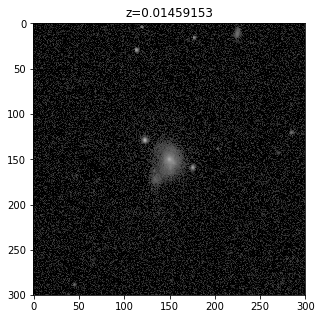

Image 201
Retrieving images...
done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726   OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- -------- --------- -------- -------- -------- -------- ------------------ ------------ ------------
430268892108056576 GALAXY       -- 0.1078142 350.41491 0.26677282   382     637 51816 6.225919 -4.907463 5.619169 4.444827 22.27233 9.293883 11.140628584698401 257043275189         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


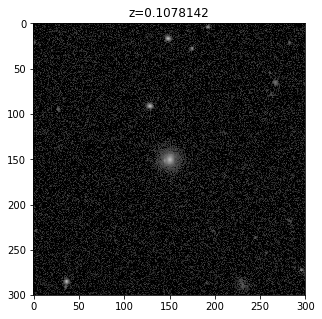

Image 202
Retrieving images...
done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD       OII3726       OIII4959 OIII5007  HBeta    HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ------------------ -------- -------- -------- -------- -------- ------------------ ------------ ------------
431300508926371840 GALAXY STARFORMING 0.02423565 350.46599 -0.69076924   383     294 51818 -37.28469000000001 2.598588 15.48566 56.16071 267.5005 87.53639 10.617812000588199 168091833870         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


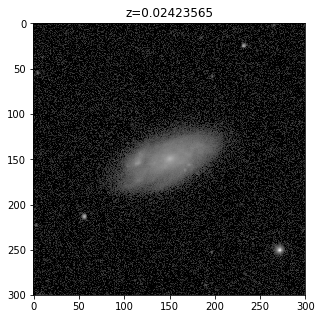

Image 203
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class   subClass     z          ra             dec          plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ --------- ---------- --------- --------------------- ----- ------- ----- -------- -------- -------- -------- -------- -------- ---------------- ------------ ------------
431292812344977408 GALAXY STARBURST 0.05678048 350.53332 -0.053945790999999986   383     266 51818 692.1503 401.7469 1231.278 469.8237 1473.047 146.8927 10.1927458010051 152986730026         True


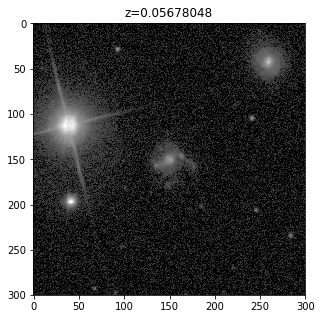

Image 204
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class  subClass     z         ra       dec     plate fiberID  MJD  OII3726       OIII4959      OIII5007  HBeta    HAlpha       NII6584             logM        galaxy_id   file_created
------------------ ------ -------- --------- --------- ---------- ----- ------- ----- -------- ------------------ -------- -------- -------- ------------------ ---------------- ------------ ------------
431375550594967552 GALAXY       -- 0.1197505 351.88177 0.87383637   383     567 51818 6.050269 0.4787899000000001 4.792366 0.701398 9.555315 6.3514089999999985 10.4937500638102 171149527329         True


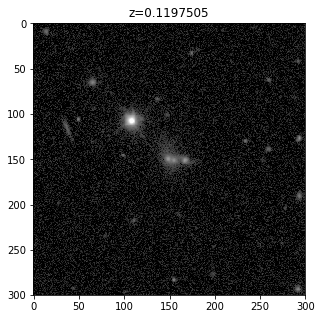

Image 205
Retrieving images...
done!
    specObjID      class  subClass     z          ra       dec    plate fiberID  MJD       OII3726        OIII4959 OIII5007  HBeta    HAlpha  NII6584        logM        galaxy_id   file_created
------------------ ------ -------- ---------- --------- --------- ----- ------- ----- ------------------ --------- -------- -------- -------- -------- ---------------- ------------ ------------
432457744964937728 GALAXY       -- 0.04426052 353.46585 1.1444845   384     408 51821 5.8877690000000005 0.5823512 1.978765 11.44549 35.47161 16.91055 10.1825672332194 594792262353         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


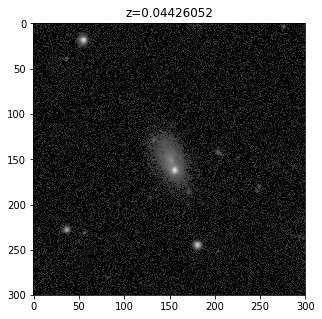

Image 206
Retrieving images...


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done!
    specObjID      class    subClass      z          ra        dec     plate fiberID  MJD       OII3726            OIII4959     OIII5007       HBeta        HAlpha  NII6584         logM         galaxy_id   file_created
------------------ ------ ----------- ---------- --------- ----------- ----- ------- ----- ------------------ ----------------- -------- ----------------- -------- -------- ------------------ ------------ ------------
433517673536579584 GALAXY STARFORMING 0.07796384 355.37783 -0.54768516   385     168 51783 22.676820000000006 7.724417999999999 10.05782 36.99469000000001 169.1563 73.43287 10.854425906758802 124285863318         True


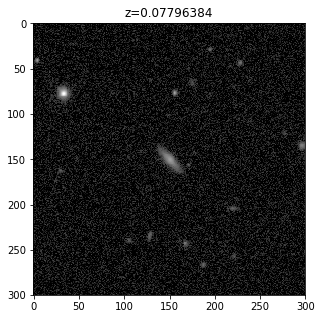

Image 207
Retrieving images...
done!
    specObjID      class  subClass     z             ra           dec     plate fiberID  MJD  OII3726  OIII4959 OIII5007  HBeta         HAlpha      NII6584         logM         galaxy_id   file_created
------------------ ------ -------- --------- ----------------- ---------- ----- ------- ----- -------- -------- -------- -------- ----------------- -------- ------------------ ------------ ------------
769121070358751232 GALAXY       -- 0.1170976 356.2648700000001 0.70657302   683     478 52524 2.369287 1.352164 4.917997 10.35256 60.78126999999999 24.76026 10.843354726828801 956014462097         True


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


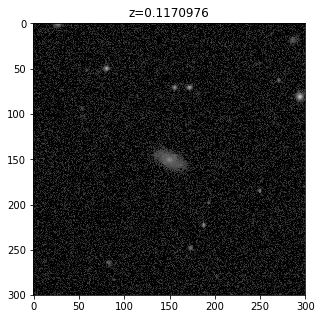

AttributeError: 'Table' object has no attribute 'to_csv'

In [12]:
prevRaDec = None
currGalId = getUUID()
currFileExists = True

sideLen = 300

outputDir = 'galaxy_cutouts_big'

# Some quick modifications
catSDSS.sort('ra')
catSDSS['galaxy_id'] = 0
catSDSS['file_created'] = False

for catIndex in range(len(catSDSS)):
    
    ctrRaDec = catSDSS['ra'][catIndex], catSDSS['dec'][catIndex]
    
    # Test: Far enough away from previous?
    if prevRaDec is not None and skyDistArcsec(ctrRaDec, prevRaDec) < 10:
        # If it's the same galaxy, give it the same ID and move on
        catSDSS[catIndex]['galaxy_id'] = currGalId
        catSDSS[catIndex]['file_created'] = currFileExists
        print('Skpping image {} (repeat)'.format(currGalId))
        continue
    
    try:
        currFileExists = False
        
        # Create new galaxy ID if it's a new galaxy
        currGalId = getUUID()
        catSDSS[catIndex]['galaxy_id'] = currGalId
        
        print('Image {}'.format(catIndex))
        print('Retrieving images...')
        srcInfo = requestPhotoObj(catSDSS['specObjID'][catIndex])
        fitsFiles = requestFitsFiles(srcInfo)
        print('done!')
        
        rCutout = makeCutout(fitsFiles['r'][0], ctrRaDec, sideLen)
        rCutout.writeto('{}/{}.fits'.format(outputDir, currGalId))
        
        currFileExists=True
        catSDSS[catIndex]['file_created'] = True
        
        prevRaDec = ctrRaDec
        
        print(catSDSS[catIndex])
        
        setImgSize(5,5)
        plt.imshow(band2RGB(rCutout.data))
        z = catSDSS[catSDSS['galaxy_id'] == currGalId]['z'][0]
        plt.title('z={}'.format(z))
        plt.show()
    except Exception as e:
        print('Exception:', e)
        
catSDSS.to_csv(path_or_buf=outputDir+'/Catalog.csv')

In [79]:
print('Catalog:', len(catSDSS))
print('Unique galaxies:', len(set(catSDSS['galaxy_id'])))

Catalog: 208
Unique galaxies: 195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

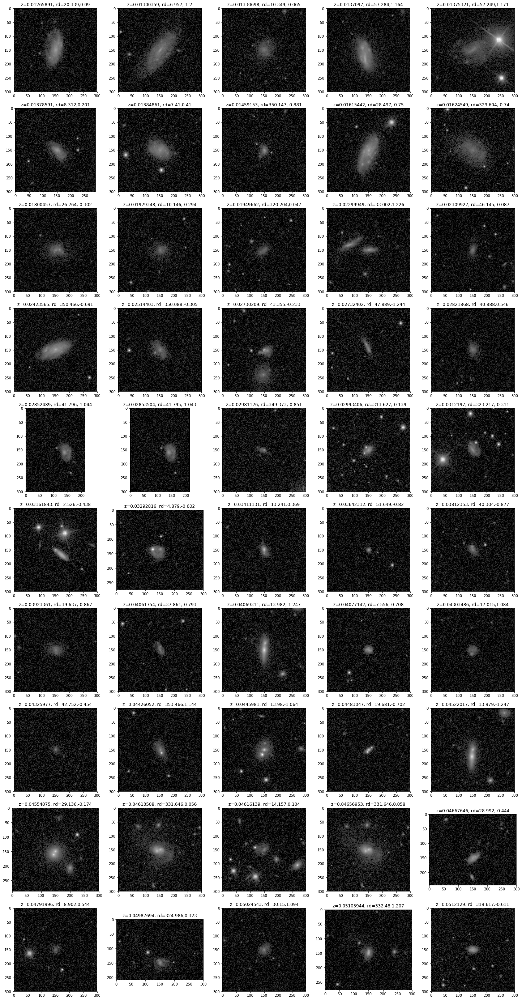

In [83]:
catSDSS.sort('z')
galIndex = 1
setImgSize(25,50)
for rowIndex in range(len(catSDSS)):
    row = catSDSS[rowIndex]
    galId = row['galaxy_id']
    z = row['z']
    ra, dec = row['ra'], row['dec']
    if row['file_created']:
        fName = 'galaxy_cutouts_big/{}.fits'.format(galId)
        currFits = fits.open(fName)
        if np.product(currFits[0].data.shape) == 0: continue
        
        plt.subplot(10, 5, galIndex)
        plt.imshow(band2RGB(currFits[0].data), cmap='gray')
        plt.title('z={}, rd={},{}'.format(z, round(ra,3), round(dec,3)))
        
        galIndex += 1
        if galIndex > 50: break
plt.show()

In [134]:
# Take a ride on the SExtractor

def getFilename(galId): return 'galaxy_cutouts_big/{}.fits'.format(galId)

def callSextractorAndLoadOutput(inputFilepath, configFilepath='sextractor_config/config.sex'):
    cmd = ['./sex_v2.5',
           inputFilepath,
           '-c',
           configFilepath]
    subprocess.call(cmd)
    return inputFilepath

In [107]:

def smoothImage(hdu, convSize):
    hduSmoothed = hdu.copy()
    hduSmoothed.data = convolve(hduSmoothed.data, Box2DKernel(convSize))
    return hduSmoothed


In [116]:
galIndices = np.random.choice(len(catSDSS), numgals)

Exception: Empty or corrupt FITS file


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


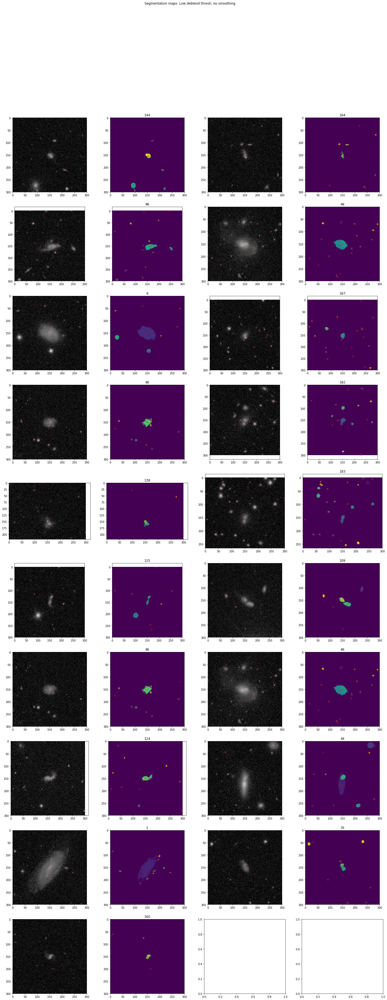

In [137]:
setImgSize(25,60)

numgals = 20
f, axes = plt.subplots(int(numgals/2), 4)
axes = axes.flatten()

axIndex = 0

convSize = 1
for index in galIndices:
    try:
        galId = catSDSS['galaxy_id'][index]
        imgFile = getFilename(galId)
        hdu = fits.open(imgFile)[0]

         # Smoothes the original image
        hduSmoothed = smoothImage(hdu, convSize)

        # Segments the image with SExtractor
        inputFilepath = './sextractor_out/sextractor_in.fits'
        hduSmoothed.writeto(inputFilepath, overwrite=True)
        
        fitsSegmented = callSextractorAndLoadOutput(inputFilepath)
        catFile = fits.open('sextractor_out/output.cat')
        catTable = Table(catFile[1].data)

        imgData = fits.open(imgFile)[0].data
        segData = fits.open('sextractor_out/segmented.fits')[0].data

        ax = axes[axIndex]
        ax.imshow(band2RGB(imgData))
        ax.scatter(catTable['X_IMAGE']-1, catTable['Y_IMAGE']-1, marker='o', alpha=0.1, color='red')
        ax = axes[axIndex+1]
        ax.imshow(segData)
        ax.scatter(catTable['X_IMAGE']-1, catTable['Y_IMAGE']-1, marker='o', alpha=0.25, color='red')
        ax.set_title(index)
        
        axIndex += 2
    except Exception as e:
        print('Exception:', e)

plt.suptitle('Segmentation maps: Low deblend thresh, no smoothing')
plt.show()

In [75]:
for index in range(10):
    galId = catSDSS['galaxy_id'][index]
    callSextractorAndLoadOutput(getFilename(galId))
    f = fits.open('sextractor_out/output.cat')
    t = Table(f[1].data)
    
    imgCenter = 

matplotlib.patches.Circle

In [139]:

catSDSS[6]

specObjID,class,subClass,z,ra,dec,plate,fiberID,MJD,OII3726,OIII4959,OIII5007,HBeta,HAlpha,NII6584,logM,galaxy_id,file_created
int64,str6,str13,float64,float64,float64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,int64,bool
440364882181777408,GALAXY,STARFORMING,0.01384861,7.4099163,0.41037371,391,502,51782,0.0,31.35988,99.56178,83.55561,262.4785,54.75702,9.59479706440307,782668678393,True
